# Convolutional Neural Networks

## Project: Write an Algorithm for a Dog Identification App 

---

In this notebook, some template code has already been provided for you, and you will need to implement additional functionality to successfully complete this project. You will not need to modify the included code beyond what is requested. Sections that begin with **'(IMPLEMENTATION)'** in the header indicate that the following block of code will require additional functionality which you must provide. Instructions will be provided for each section, and the specifics of the implementation are marked in the code block with a 'TODO' statement. Please be sure to read the instructions carefully! 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the Jupyter Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to **File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question X'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut.  Markdown cells can be edited by double-clicking the cell to enter edit mode.

The rubric contains _optional_ "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. If you decide to pursue the "Stand Out Suggestions", you should include the code in this Jupyter notebook.



---
### Why We're Here 

In this notebook, you will make the first steps towards developing an algorithm that could be used as part of a mobile or web app.  At the end of this project, your code will accept any user-supplied image as input.  If a dog is detected in the image, it will provide an estimate of the dog's breed.  If a human is detected, it will provide an estimate of the dog breed that is most resembling.  The image below displays potential sample output of your finished project (... but we expect that each student's algorithm will behave differently!). 

![Sample Dog Output](images/sample_dog_output.png)

In this real-world setting, you will need to piece together a series of models to perform different tasks; for instance, the algorithm that detects humans in an image will be different from the CNN that infers dog breed.  There are many points of possible failure, and no perfect algorithm exists.  Your imperfect solution will nonetheless create a fun user experience!

### The Road Ahead

We break the notebook into separate steps.  Feel free to use the links below to navigate the notebook.

* [Step 0](#step0): Import Datasets
* [Step 1](#step1): Detect Humans
* [Step 2](#step2): Detect Dogs
* [Step 3](#step3): Create a CNN to Classify Dog Breeds (from Scratch)
* [Step 4](#step4): Create a CNN to Classify Dog Breeds (using Transfer Learning)
* [Step 5](#step5): Write your Algorithm
* [Step 6](#step6): Test Your Algorithm

---
<a id='step0'></a>
## Step 0: Import Datasets

Make sure that you've downloaded the required human and dog datasets:
* Download the [dog dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/dogImages.zip).  Unzip the folder and place it in this project's home directory, at the location `/dogImages`. 

* Download the [human dataset](https://s3-us-west-1.amazonaws.com/udacity-aind/dog-project/lfw.zip).  Unzip the folder and place it in the home directory, at location `/lfw`.  

*Note: If you are using a Windows machine, you are encouraged to use [7zip](http://www.7-zip.org/) to extract the folder.*

In the code cell below, we save the file paths for both the human (LFW) dataset and dog dataset in the numpy arrays `human_files` and `dog_files`.

In [1]:
!pip install --upgrade pip
!pip install torch
!pip install torchvision
!pip install -U numpy
!pip show numpy

# Source: https://machinelearningmastery.com/how-to-perform-face-detection-with-classical-and-deep-learning-methods-in-python-with-keras/
!pip install mtcnn==0.0.9
!pip show mtcnn
!pip install --upgrade pillow


Requirement already up-to-date: pip in /anaconda3/lib/python3.7/site-packages (19.3.1)
Requirement already up-to-date: numpy in /anaconda3/lib/python3.7/site-packages (1.17.4)
Name: numpy
Version: 1.17.4
Summary: NumPy is the fundamental package for array computing with Python.
Home-page: https://www.numpy.org
Author: Travis E. Oliphant et al.
Author-email: None
License: BSD
Location: /anaconda3/lib/python3.7/site-packages
Requires: 
Required-by: torchvision, torch, tensorflow, tensorboard, tables, seaborn, scikit-learn, PyWavelets, pytest-doctestplus, pytest-arraydiff, patsy, pandas, opencv-python, odo, numexpr, numba, mkl-random, mkl-fft, matplotlib, Keras, Keras-Preprocessing, Keras-Applications, h5py, datashape, Bottleneck, bokeh, bkcharts, astropy, gym
Name: mtcnn
Version: 0.0.9
Summary: Multi-task Cascaded Convolutional Neural Networks for Face Detection, based on TensorFlow
Home-page: http://github.com/ipazc/mtcnn
Author: Iván de Paz Centeno
Author-email: ipazc@unileon.es
Licens

In [1]:
import numpy as np
from glob import glob
import cv2                
from tqdm import tqdm

import matplotlib.pyplot as plt  
from matplotlib.patches import Rectangle   
from matplotlib.pyplot import imshow
%matplotlib inline    
from keras.utils import np_utils

import torch
import torchvision.models as models
import torchvision.transforms as transforms
from torch.autograd import Variable
from torchvision import datasets, transforms

import io
import requests

from PIL import Image

import os

# the following import is required for training to be robust to truncated images
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

# check if CUDA is available
use_cuda = torch.cuda.is_available()


Using TensorFlow backend.


In [2]:
# load filenames for human and dog images
human_files = np.array(glob("/data/lfw/*/*"))
dog_files = np.array(glob("/data/dog_images/*/*/*"))

# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8351 total dog images.


<a id='step1'></a>
## Step 1: Detect Humans

In this section, we use OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  

OpenCV provides many pre-trained face detectors, stored as XML files on [github](https://github.com/opencv/opencv/tree/master/data/haarcascades).  We have downloaded one of these detectors and stored it in the `haarcascades` directory.  In the next code cell, we demonstrate how to use this detector to find human faces in a sample image.

Number of faces detected: 1


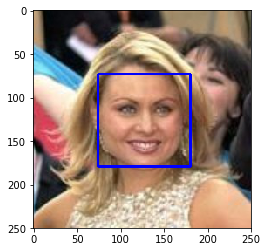

In [3]:
# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[100])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()

Before using any of the face detectors, it is standard procedure to convert the images to grayscale.  The `detectMultiScale` function executes the classifier stored in `face_cascade` and takes the grayscale image as a parameter.  

In the above code, `faces` is a numpy array of detected faces, where each row corresponds to a detected face.  Each detected face is a 1D array with four entries that specifies the bounding box of the detected face.  The first two entries in the array (extracted in the above code as `x` and `y`) specify the horizontal and vertical positions of the top left corner of the bounding box.  The last two entries in the array (extracted here as `w` and `h`) specify the width and height of the box.

### Write a Human Face Detector

We can use this procedure to write a function that returns `True` if a human face is detected in an image and `False` otherwise.  This function, aptly named `face_detector`, takes a string-valued file path to an image as input and appears in the code block below.

In [4]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

### (IMPLEMENTATION) Assess the Human Face Detector

__Question 1:__ Use the code cell below to test the performance of the `face_detector` function.  
- What percentage of the first 100 images in `human_files` have a detected human face?  
- What percentage of the first 100 images in `dog_files` have a detected human face? 

Ideally, we would like 100% of human images with a detected face and 0% of dog images with a detected face.  You will see that our algorithm falls short of this goal, but still gives acceptable performance.  We extract the file paths for the first 100 images from each of the datasets and store them in the numpy arrays `human_files_short` and `dog_files_short`.

__Answer:__ 
(You can print out your results and/or write your percentages in this cell)

In [10]:
human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

#-#-# Do NOT modify the code above this line. #-#-#

## TODO: Test the performance of the face_detector algorithm 
## on the images in human_files_short and dog_files_short.

count_human_faces = 0
count_dog_faces_as_human_faces = 0


for image_path_human, image_path_dog in zip(human_files_short, dog_files_short):
  
  if face_detector(image_path_human) == True:
    count_human_faces += 1
  
  if face_detector(image_path_dog) == True:
    count_dog_faces_as_human_faces += 1
    
print('Percentage of detected human faces: ', count_human_faces, '%')
print('Percentage of detected dog faces as human faces: ', count_dog_faces_as_human_faces,'%')


Percentage of detected human faces:  98 %
Percentage of detected dog faces as human faces:  17 %


## Face Detection With Deep Learning

A number of deep learning methods have been developed and demonstrated for face detection.

Perhaps one of the more popular approaches is called the “Multi-Task Cascaded Convolutional Neural Network,” or MTCNN for short, described by [Kaipeng Zhang, et al.](http://kpzhang93.github.io/) in the 2016 paper titled “Joint Face Detection and Alignment Using Multitask Cascaded Convolutional Networks.”

The following code lines are inspired by [How to Perform Face Detection with Deep Learning in Keras](https://machinelearningmastery.com/how-to-perform-face-detection-with-classical-and-deep-learning-methods-in-python-with-keras/)

Please use the code cell below to design and test your own face detection algorithm.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

W1214 15:52:27.570947 4713469376 deprecation_wrapper.py:119] From /anaconda3/lib/python3.7/site-packages/mtcnn/mtcnn.py:187: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W1214 15:52:28.309872 4713469376 deprecation_wrapper.py:119] From /anaconda3/lib/python3.7/site-packages/mtcnn/mtcnn.py:193: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

W1214 15:52:28.355413 4713469376 deprecation_wrapper.py:119] From /anaconda3/lib/python3.7/site-packages/mtcnn/network.py:43: The name tf.variable_scope is deprecated. Please use tf.compat.v1.variable_scope instead.

W1214 15:52:28.356258 4713469376 deprecation_wrapper.py:119] From /anaconda3/lib/python3.7/site-packages/mtcnn/layer_factory.py:88: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W1214 15:52:28.375128 4713469376 deprecation_wrapper.py:119] From /anaconda3/lib/python3.7/site-packages/mtcnn/layer_factory.py:79: The name tf.get_variab

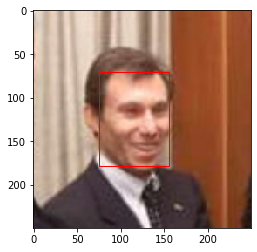

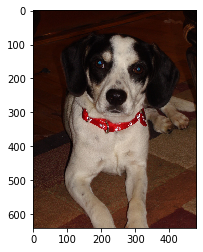

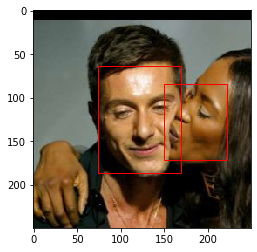

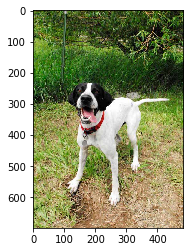

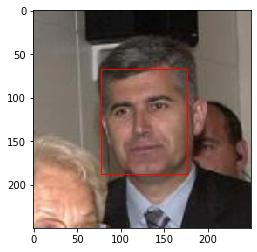

...

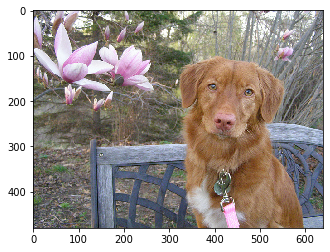

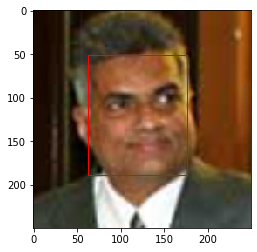

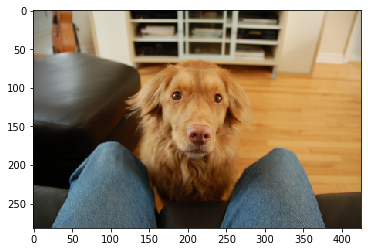

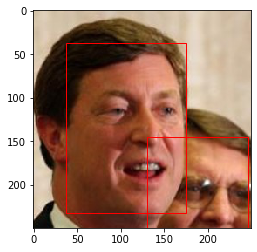

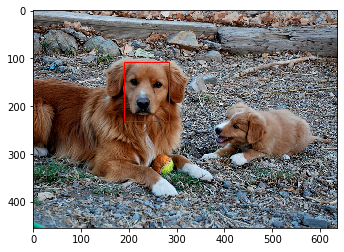

Percentage of detected human faces:  100 %
Percentage of detected dog faces as human faces:  16 %


In [100]:
### (Optional) 
### TODO: Test performance of anotherface detection algorithm.
### Feel free to use as many code cells as needed.

# face detection with mtcnn on a photograph
from mtcnn.mtcnn import MTCNN

# create the detector, using default weights
detector = MTCNN()

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

# draw an image with detected objects
def draw_image_with_boxes(filename, result_list, index):
    # load the image
    data = plt.imread(filename)
    # plot the image
    plt.imshow(data)
    # get the context for drawing boxes
    ax = plt.gca()
    # plot each box
    for result in result_list:
        # get coordinates
        x, y, width, height = result['box']
        # create the shape
        rect = Rectangle((x, y), width, height, fill=False, color='red')
        # draw the box
        ax.add_patch(rect)
    # show the plot
    plt.show()

count_human_faces = 0
count_dog_faces_as_human_faces = 0
index = 0

for image_path_human, image_path_dog in zip(human_files_short, dog_files_short):
    #pixels_human = plt.imread(image_path_human)
    #pixels_dog = plt.imread(image_path_dog)
    pixels_human = cv2.cvtColor(cv2.imread(image_path_human), cv2.COLOR_BGR2RGB)
    pixels_dog = cv2.cvtColor(cv2.imread(image_path_dog), cv2.COLOR_BGR2RGB)
    # detect faces in the image
    faces_human = detector.detect_faces(pixels_human)
    faces_dog = detector.detect_faces(pixels_dog)
    # display faces on the original image
    if index < 20:
        draw_image_with_boxes(image_path_human, faces_human, index)
        draw_image_with_boxes(image_path_dog, faces_dog, index)
        index += 1
  
    for face in faces_human:
        if len(face['box']) >0:
            count_human_faces += 1
            break
  
    for face in faces_dog:
        if len(face['box']) >0:
            count_dog_faces_as_human_faces += 1
            break
    
print('Percentage of detected human faces: ', count_human_faces, '%')
print('Percentage of detected dog faces as human faces: ', count_dog_faces_as_human_faces,'%')

## Result
The usage of the MTCNN face detector trained on a Cascaded Convolutional Neural Network leads to better result with regard to the detection of human faces than the usage of the OpenCV face_detector. 100% of human faces in the human_files_short list were correctly detected. The wrong detection of dog faces in the range of 20% is comparable to the result by using the OpenCV approach, however. 

Percentage of detected human faces:  100 %
Percentage of detected dog faces as human faces:  16 %

---
<a id='step2'></a>
## Step 2: Detect Dogs

In this section, we use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model

The code cell below downloads the VGG-16 model, along with weights that have been trained on [ImageNet](http://www.image-net.org/), a very large, very popular dataset used for image classification and other vision tasks.  ImageNet contains over 10 million URLs, each linking to an image containing an object from one of [1000 categories](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).  

In [5]:
# define VGG16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()
    
print(VGG16)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.torch/models/vgg16-397923af.pth
100%|██████████| 553433881/553433881 [00:07<00:00, 71482026.42it/s]


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (17): Conv2d

Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### (IMPLEMENTATION) Making Predictions with a Pre-trained Model

In the next code cell, you will write a function that accepts a path to an image (such as `'dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg'`) as input and returns the index corresponding to the ImageNet class that is predicted by the pre-trained VGG-16 model.  The output should always be an integer between 0 and 999, inclusive.

Before writing the function, make sure that you take the time to learn  how to appropriately pre-process tensors for pre-trained models in the [PyTorch documentation](http://pytorch.org/docs/stable/torchvision/models.html).

In [6]:
def transform_to_tensor(img_path):
    # code from Style transfer section
    # define transforms for the training data and testing data
    transform_img_size = 224
    transform_crop = 224
    transform = transforms.Compose([transforms.Resize(transform_img_size),
                                    transforms.CenterCrop(transform_crop),
                                    transforms.ToTensor(),
                                    transforms.Normalize([0.485, 0.456, 0.406],
                                                        [0.229, 0.224, 0.225])])
    
    # load the image
    image = Image.open(img_path).convert('RGB')  # Read bytes and store as an img.
    image = transform(image)[:3,:,:]
    # PyTorch pretrained models expect the Tensor dims to be (num input imgs, num color channels, height, width).
    # Currently however, we have (num color channels, height, width); let's fix this by inserting a new axis.
    image = image.unsqueeze(0)  # Insert the new axis at index 0 i.e. in front of the other axes/dims. 
    
    return image

In [7]:
# code from Style transfer section
# and converting it from a Tensor image to a NumPy image for display
def im_convert(tensor):
    """ Display a tensor as an image. """
    
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.229, 0.224, 0.225)) + np.array((0.485, 0.456, 0.406))
    image = image.clip(0, 1)

    return image

In [8]:
def VGG16_predict(img_path):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## TODO: Complete the function.
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    
    VGG16.eval()
    # Implement image transformations
    img = transform_to_tensor(img_path)
        
    # get sample outputs
    output = VGG16(img)  # Returns a Tensor of shape (batch, num class labels)
    _, preds_tensor = torch.max(output, 1)  # Our prediction will be the index of the class label with the largest value.
    #print(labels[prediction])  # Converts the index to a string using our labels dict
    
    return preds_tensor # predicted class index

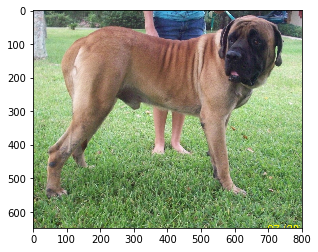

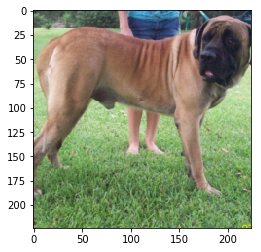

Predicted index:  tensor([ 243])


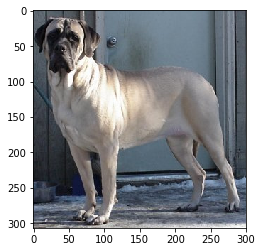

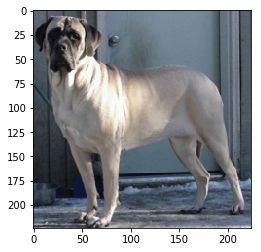

Predicted index:  tensor([ 243])


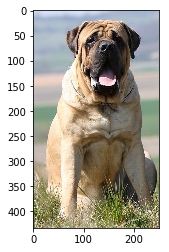

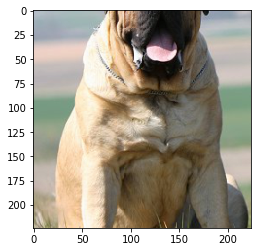

Predicted index:  tensor([ 243])


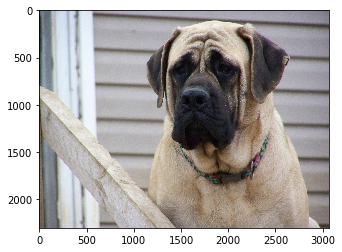

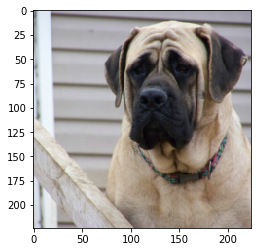

Predicted index:  tensor([ 243])


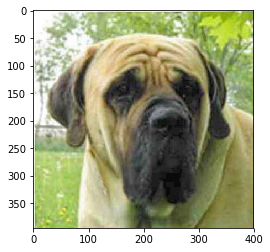

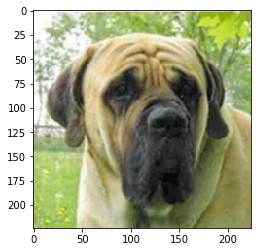

Predicted index:  tensor([ 243])


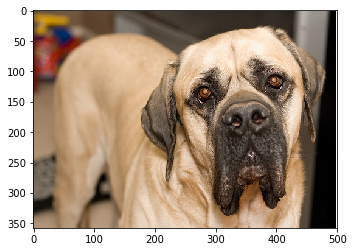

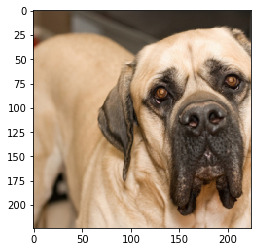

Predicted index:  tensor([ 243])


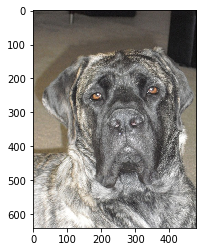

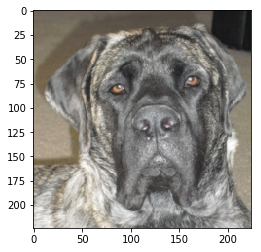

Predicted index:  tensor([ 243])


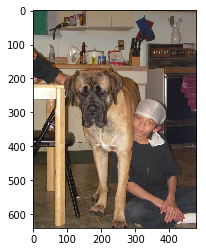

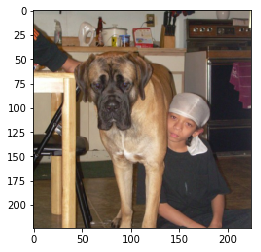

Predicted index:  tensor([ 243])


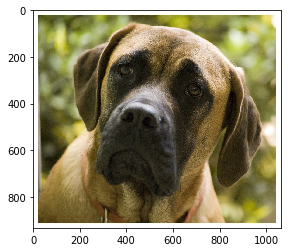

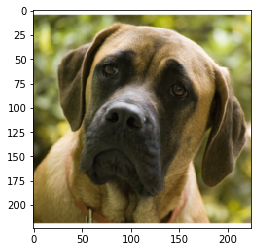

Predicted index:  tensor([ 243])


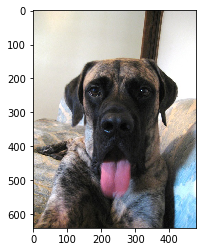

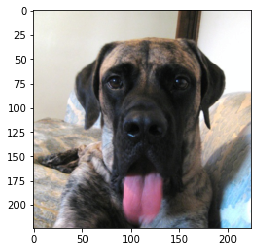

Predicted index:  tensor([ 243])


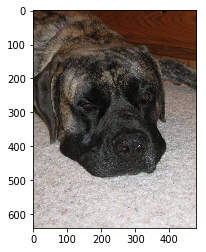

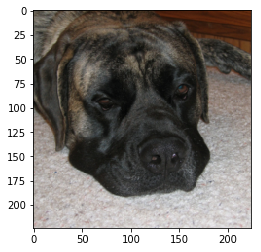

Predicted index:  tensor([ 243])


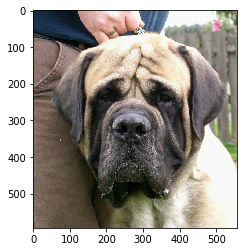

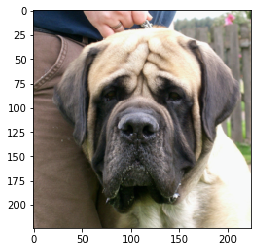

Predicted index:  tensor([ 243])


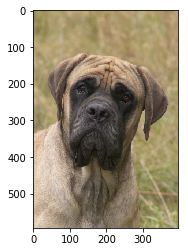

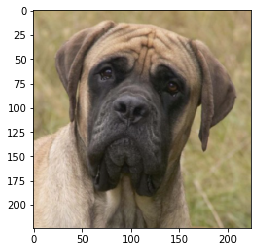

Predicted index:  tensor([ 243])


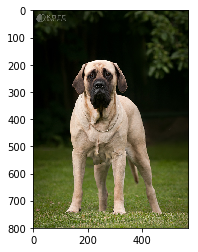

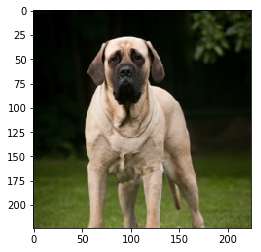

Predicted index:  tensor([ 243])


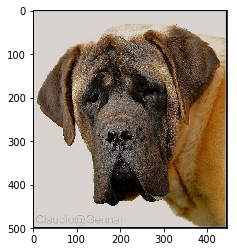

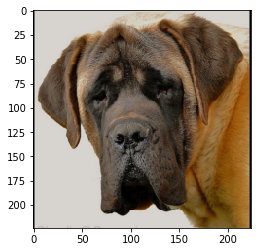

Predicted index:  tensor([ 243])


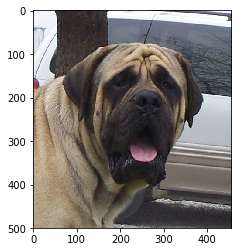

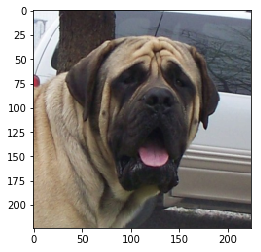

Predicted index:  tensor([ 243])


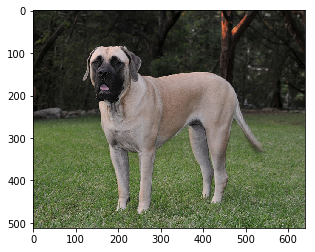

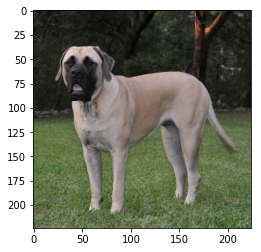

Predicted index:  tensor([ 243])


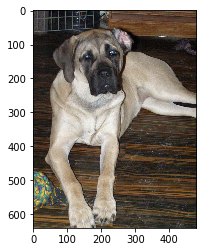

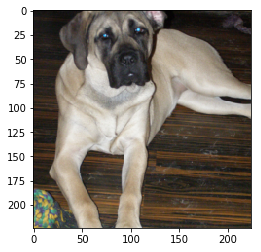

Predicted index:  tensor([ 243])


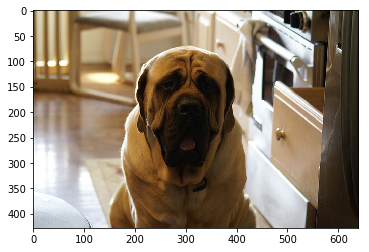

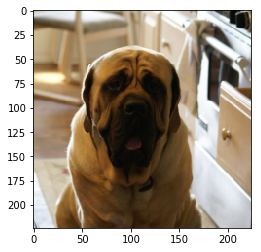

Predicted index:  tensor([ 243])


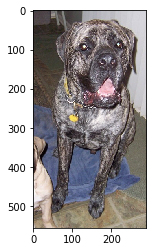

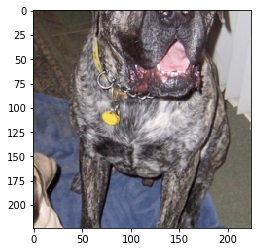

Predicted index:  tensor([ 243])


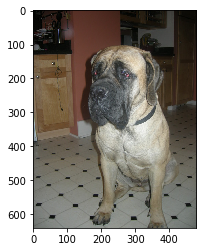

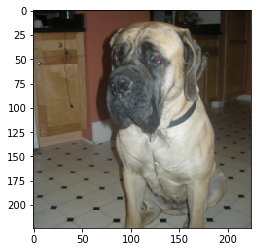

Predicted index:  tensor([ 243])


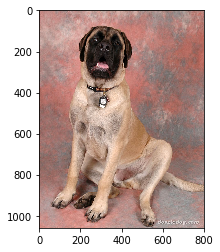

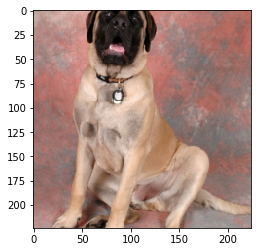

Predicted index:  tensor([ 243])


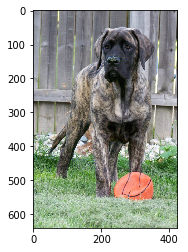

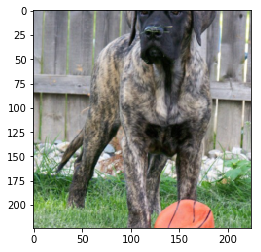

Predicted index:  tensor([ 246])


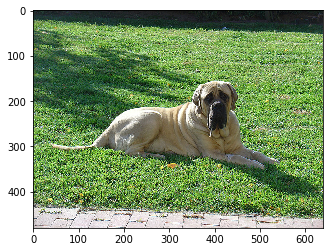

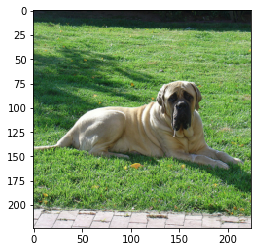

Predicted index:  tensor([ 243])


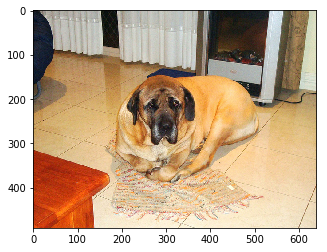

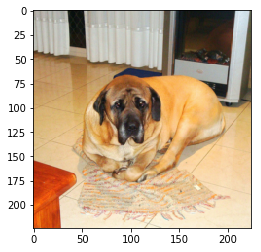

Predicted index:  tensor([ 163])


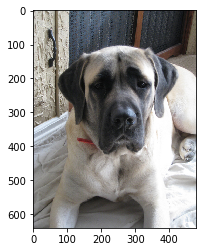

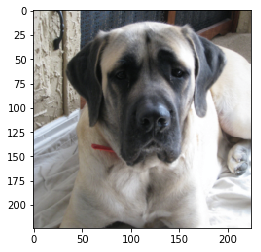

Predicted index:  tensor([ 243])


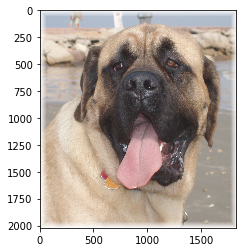

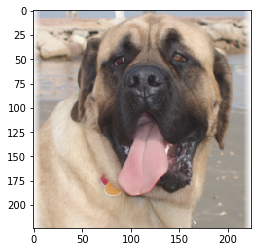

Predicted index:  tensor([ 243])


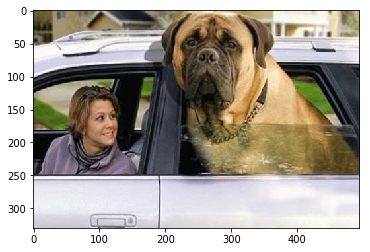

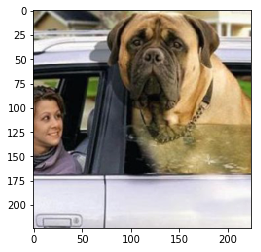

Predicted index:  tensor([ 243])


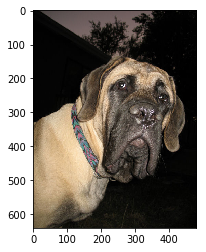

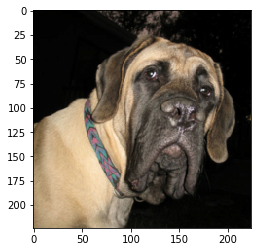

Predicted index:  tensor([ 243])


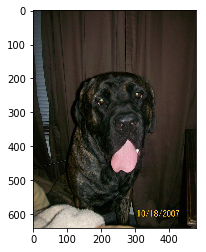

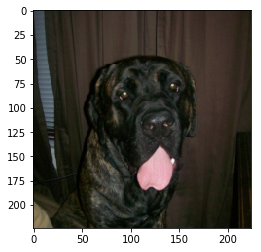

Predicted index:  tensor([ 243])


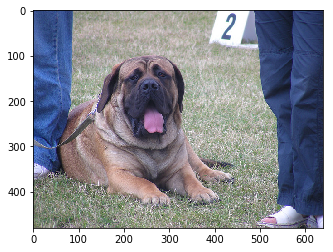

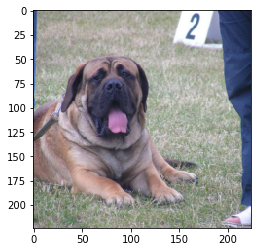

Predicted index:  tensor([ 243])


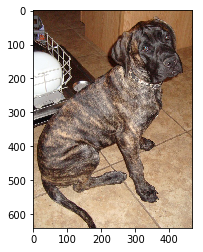

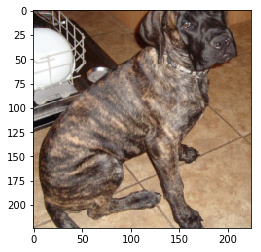

Predicted index:  tensor([ 243])


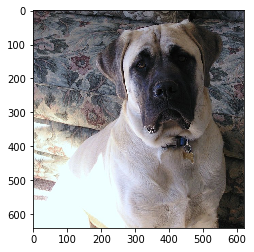

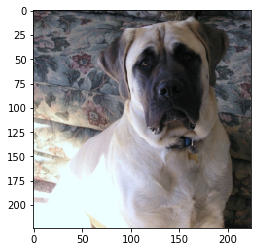

Predicted index:  tensor([ 243])


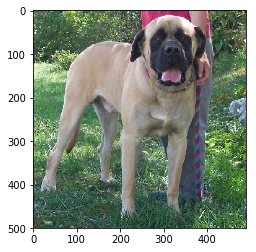

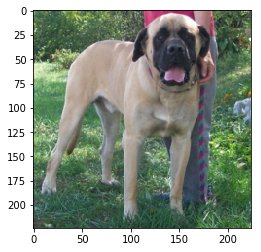

Predicted index:  tensor([ 243])


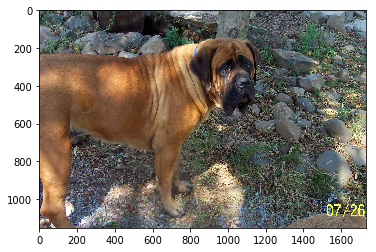

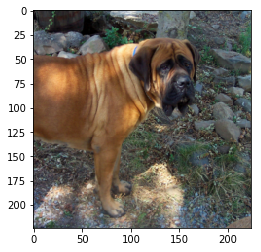

Predicted index:  tensor([ 243])


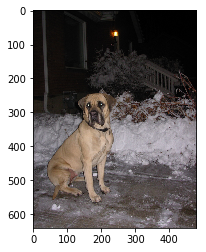

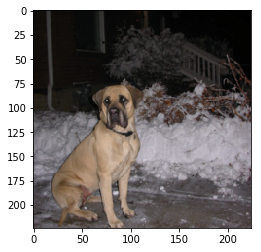

Predicted index:  tensor([ 243])


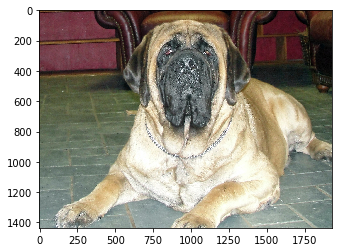

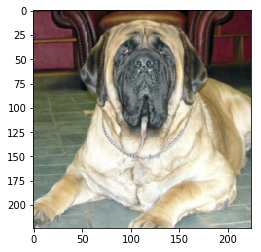

Predicted index:  tensor([ 243])


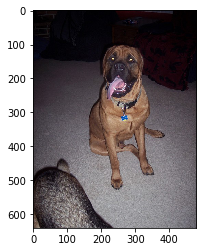

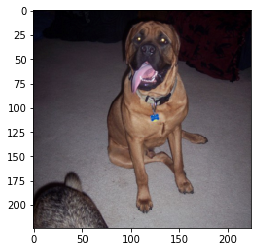

Predicted index:  tensor([ 243])


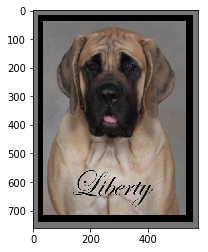

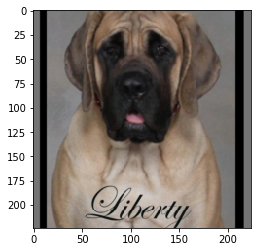

Predicted index:  tensor([ 243])


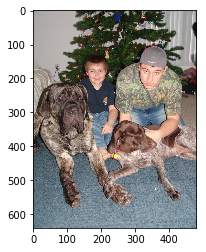

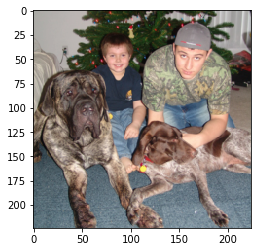

Predicted index:  tensor([ 243])


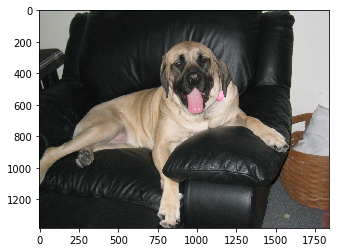

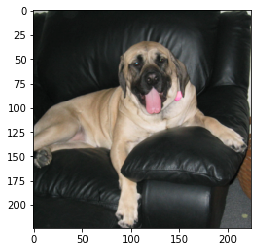

Predicted index:  tensor([ 243])


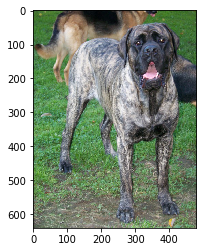

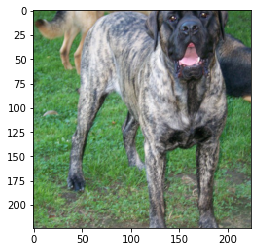

Predicted index:  tensor([ 243])


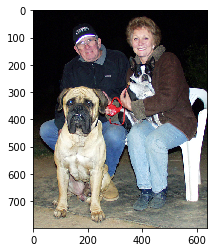

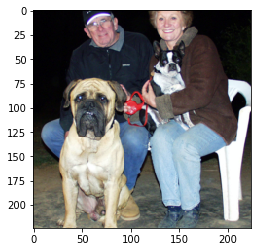

Predicted index:  tensor([ 243])


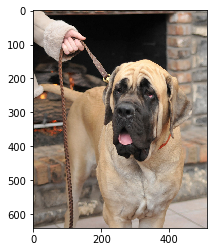

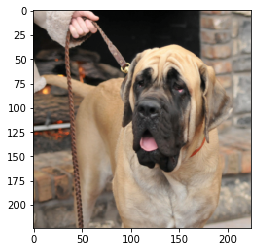

Predicted index:  tensor([ 243])


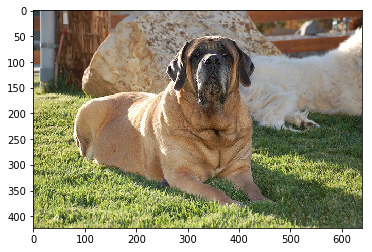

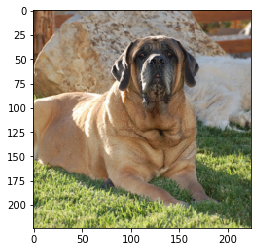

Predicted index:  tensor([ 243])


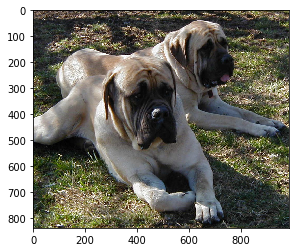

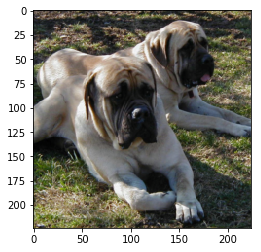

Predicted index:  tensor([ 243])


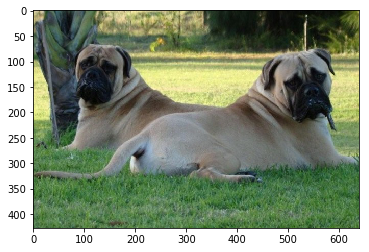

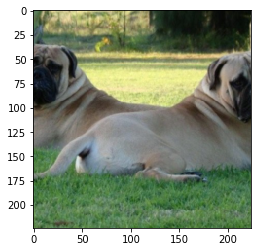

Predicted index:  tensor([ 243])


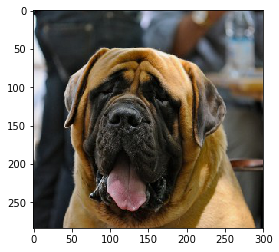

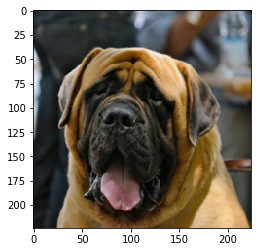

Predicted index:  tensor([ 243])


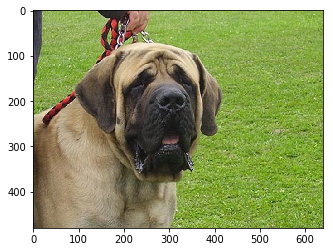

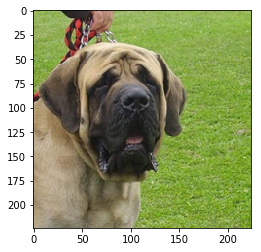

Predicted index:  tensor([ 243])


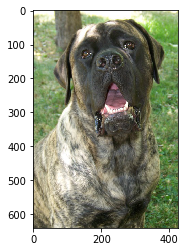

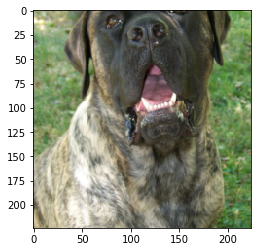

Predicted index:  tensor([ 243])


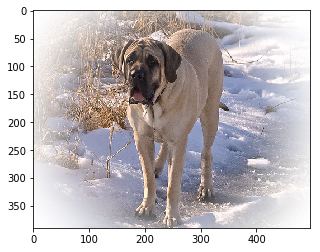

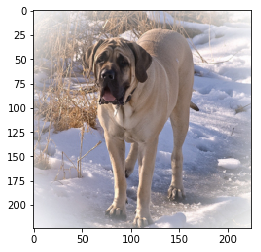

Predicted index:  tensor([ 243])


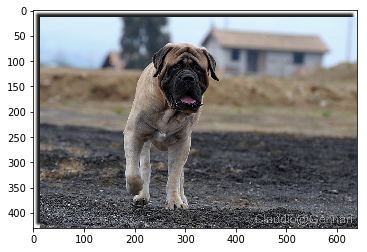

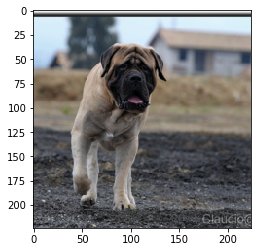

Predicted index:  tensor([ 243])


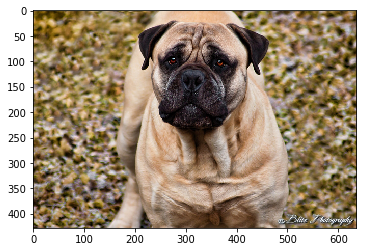

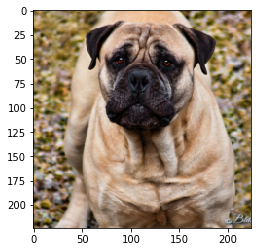

Predicted index:  tensor([ 243])


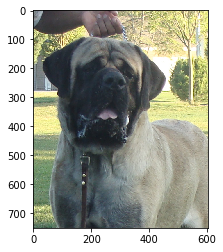

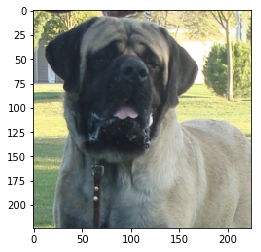

Predicted index:  tensor([ 243])


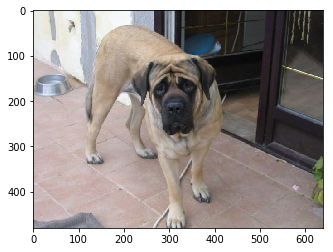

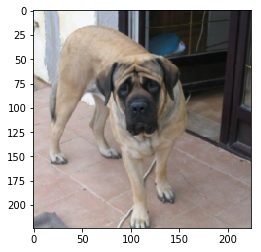

Predicted index:  tensor([ 243])


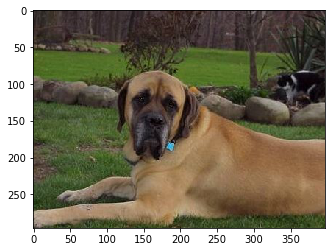

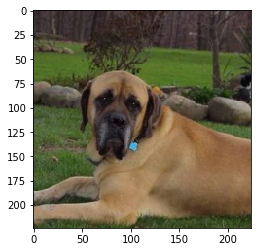

Predicted index:  tensor([ 243])


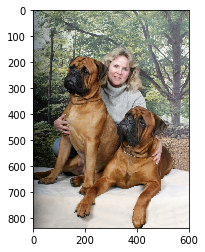

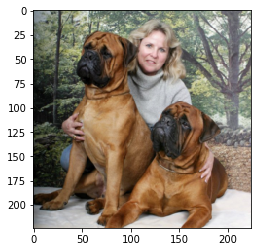

Predicted index:  tensor([ 243])


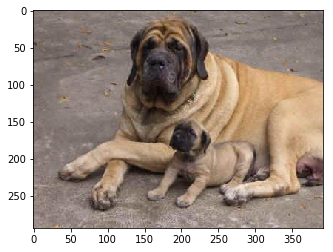

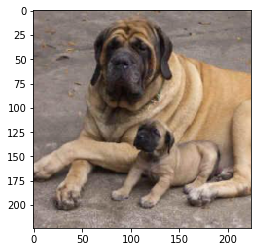

Predicted index:  tensor([ 243])


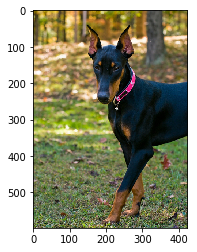

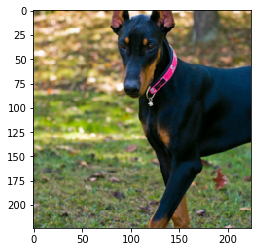

Predicted index:  tensor([ 236])


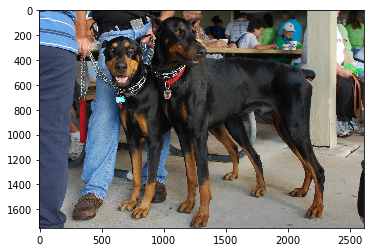

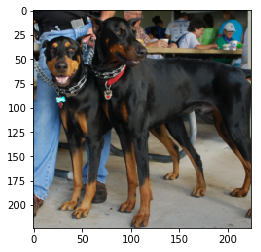

Predicted index:  tensor([ 236])


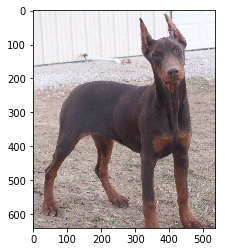

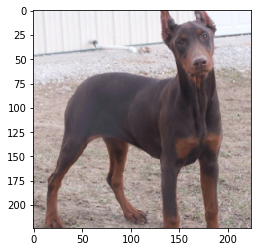

Predicted index:  tensor([ 236])


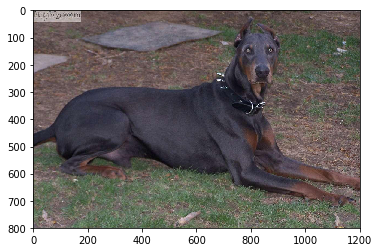

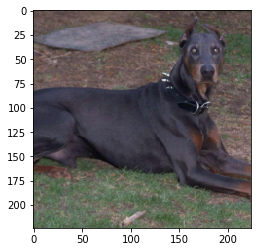

Predicted index:  tensor([ 236])


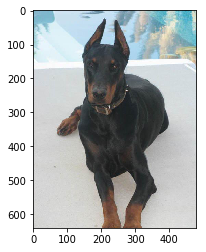

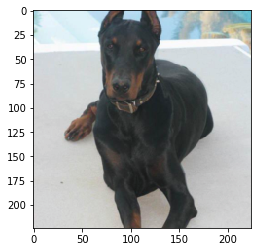

Predicted index:  tensor([ 236])


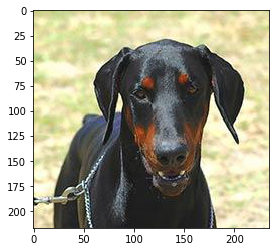

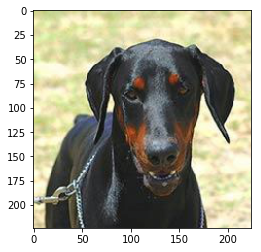

Predicted index:  tensor([ 236])


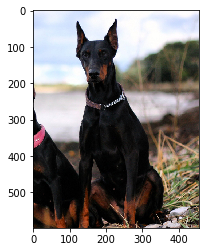

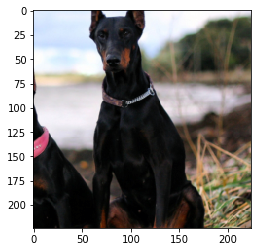

Predicted index:  tensor([ 236])


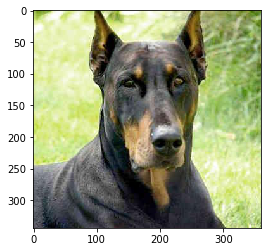

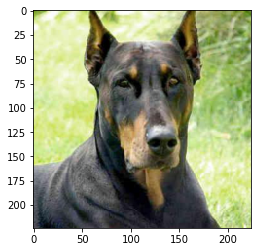

Predicted index:  tensor([ 236])


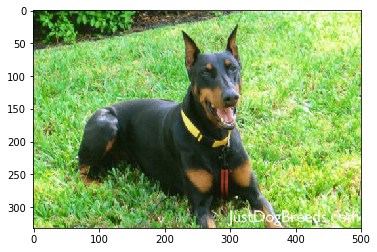

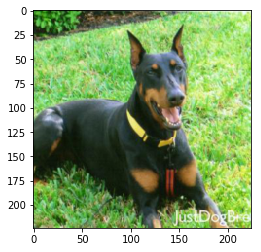

Predicted index:  tensor([ 236])


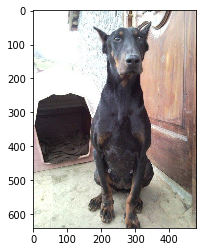

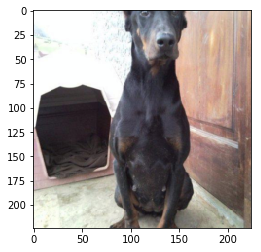

Predicted index:  tensor([ 236])


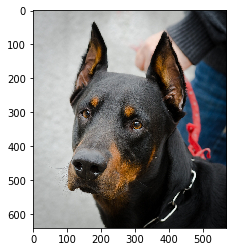

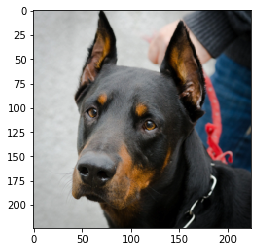

Predicted index:  tensor([ 236])


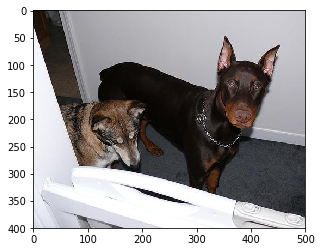

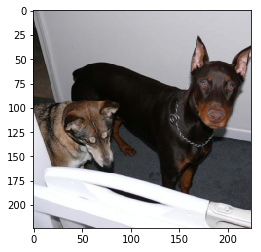

Predicted index:  tensor([ 236])


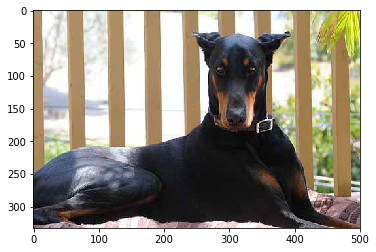

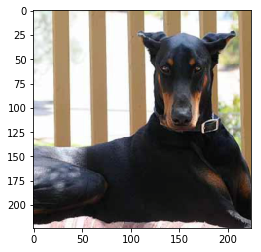

Predicted index:  tensor([ 236])


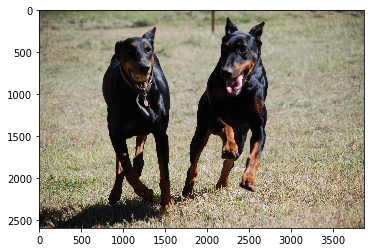

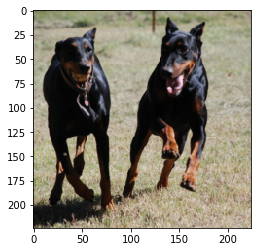

Predicted index:  tensor([ 236])


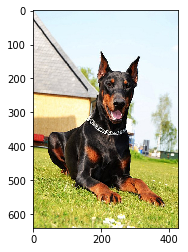

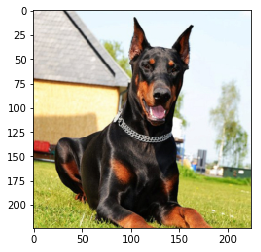

Predicted index:  tensor([ 236])


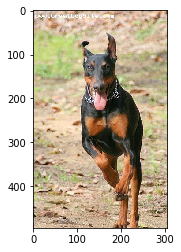

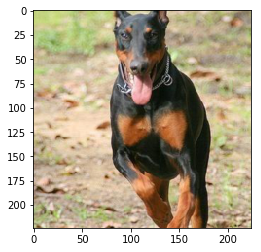

Predicted index:  tensor([ 236])


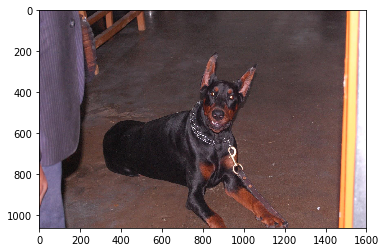

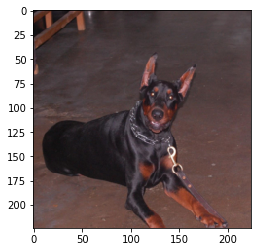

Predicted index:  tensor([ 236])


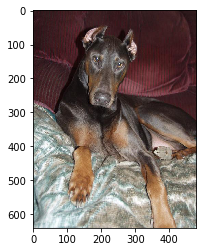

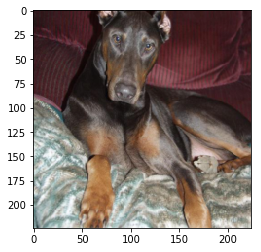

Predicted index:  tensor([ 236])


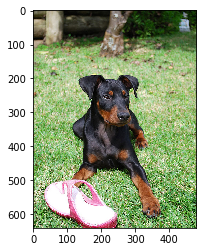

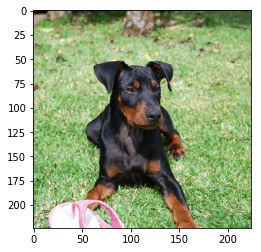

Predicted index:  tensor([ 236])


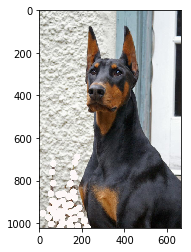

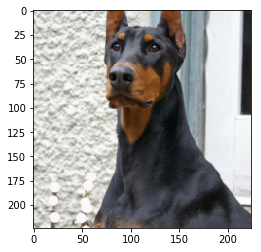

Predicted index:  tensor([ 236])


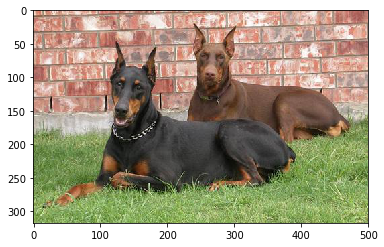

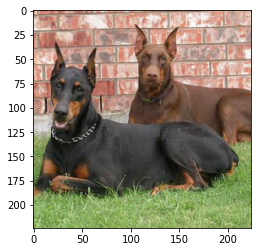

Predicted index:  tensor([ 236])


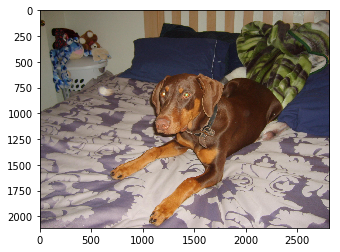

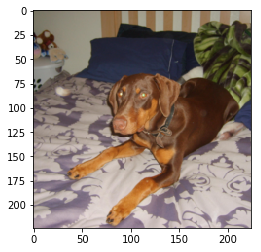

Predicted index:  tensor([ 168])


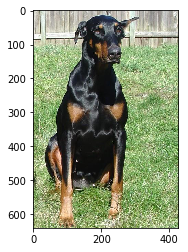

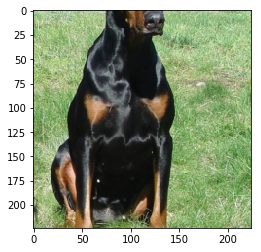

Predicted index:  tensor([ 236])


In [ ]:
for image_path_human, image_path_dog in zip(human_files_short, dog_files_short):
 
    img_path = image_path_dog
    # Let's take a look!
    img_original = plt.imread(img_path)
    # plot the original image
    plt.imshow(img_original)
    plt.show()

    # plot the Tensor image
    img = transform_to_tensor(img_path)
    plt.imshow(im_convert(img))
    plt.show()
    
    #VGG16_predict(dog_files[1])
    print('Predicted index: ', VGG16_predict(image_path_dog))


### (IMPLEMENTATION) Write a Dog Detector

While looking at the [dictionary](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a), you will notice that the categories corresponding to dogs appear in an uninterrupted sequence and correspond to dictionary keys 151-268, inclusive, to include all categories from `'Chihuahua'` to `'Mexican hairless'`.  Thus, in order to check to see if an image is predicted to contain a dog by the pre-trained VGG-16 model, we need only check if the pre-trained model predicts an index between 151 and 268 (inclusive).

Use these ideas to complete the `dog_detector` function below, which returns `True` if a dog is detected in an image (and `False` if not).

In [9]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    ## TODO: Complete the function.
    pred_index = VGG16_predict(img_path)
    return ((pred_index <= 268) & (pred_index >= 151)) # true/false

### (IMPLEMENTATION) Assess the Dog Detector

__Question 2:__ Use the code cell below to test the performance of your `dog_detector` function.  
- What percentage of the images in `human_files_short` have a detected dog?  
- What percentage of the images in `dog_files_short` have a detected dog?

__Answer:__ 


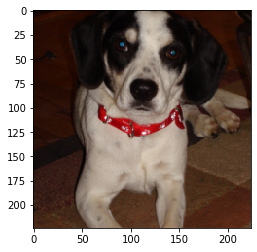

tensor([162])
tensor([True])


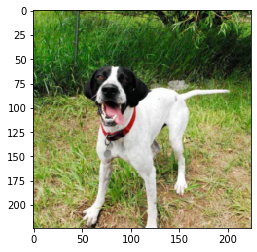

tensor([162])
tensor([True])


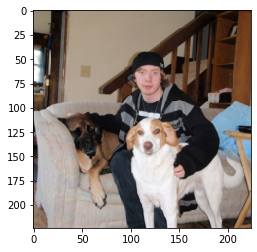

tensor([162])
tensor([True])


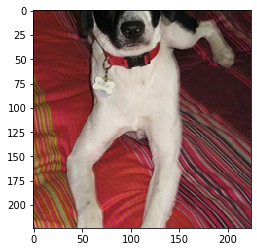

tensor([162])
tensor([True])


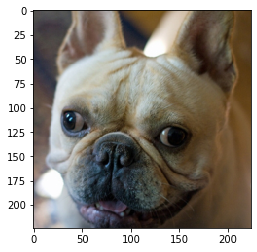

tensor([162])
tensor([True])


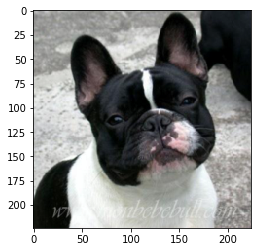

tensor([162])
tensor([True])


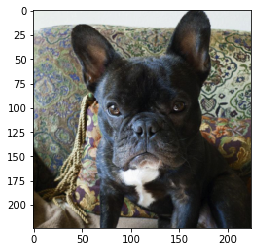

tensor([162])
tensor([True])


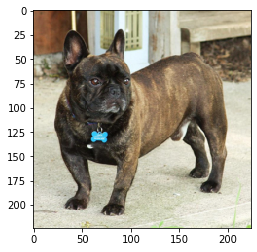

tensor([162])
tensor([True])


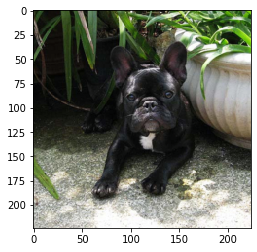

tensor([162])
tensor([True])


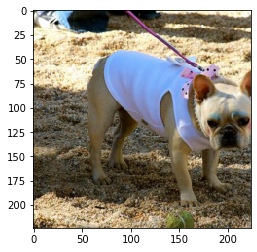

tensor([162])
tensor([True])


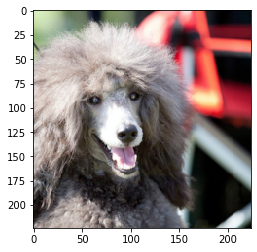

tensor([162])
tensor([True])


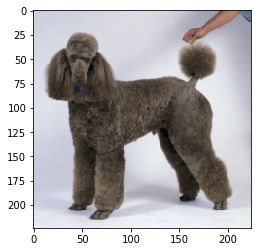

tensor([162])
tensor([True])


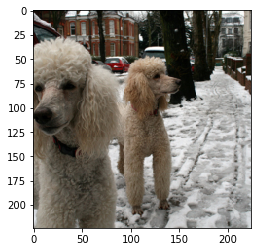

tensor([162])
tensor([True])


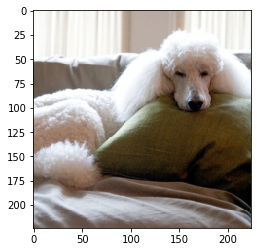

tensor([162])
tensor([True])


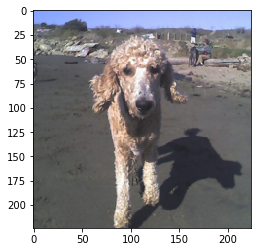

tensor([162])
tensor([True])


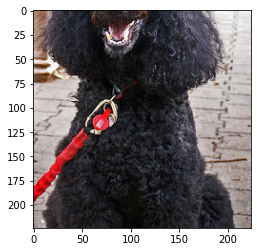

tensor([162])
tensor([True])


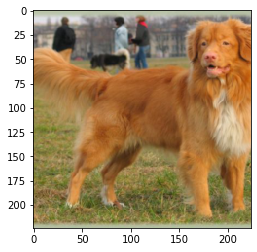

tensor([162])
tensor([True])


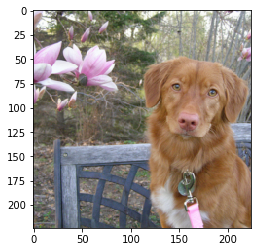

tensor([162])
tensor([True])


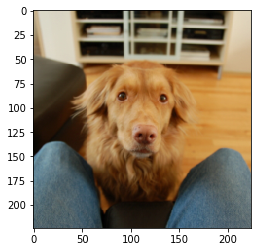

tensor([162])
tensor([True])


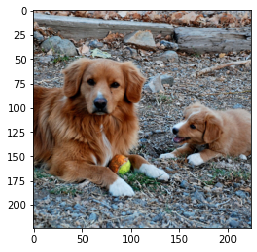

tensor([162])
tensor([True])


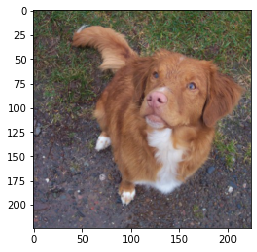

tensor([162])
tensor([True])


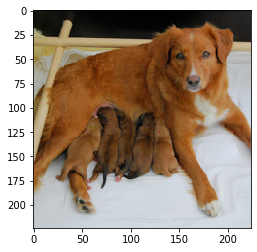

tensor([162])
tensor([True])


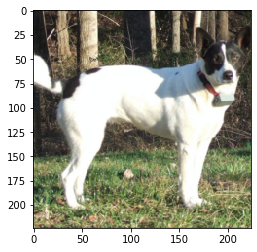

tensor([162])
tensor([True])


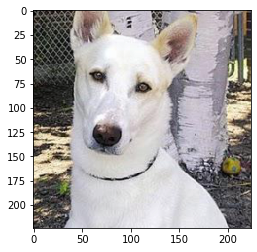

tensor([162])
tensor([True])


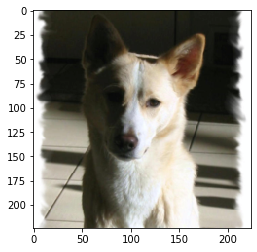

tensor([162])
tensor([True])


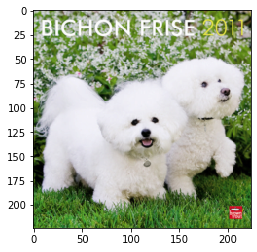

tensor([162])
tensor([True])


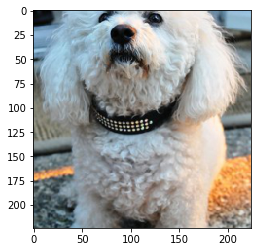

tensor([162])
tensor([True])


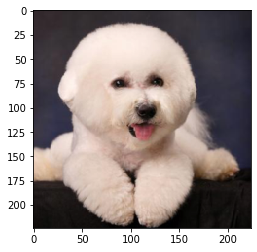

tensor([162])
tensor([True])


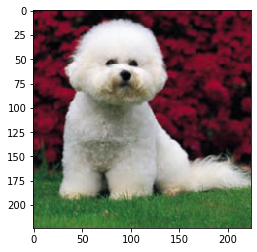

tensor([162])
tensor([True])


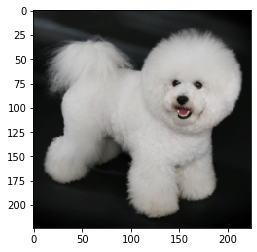

tensor([162])
tensor([True])


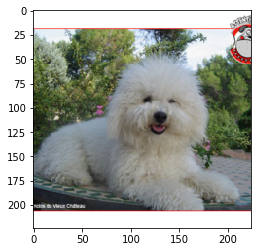

tensor([162])
tensor([True])


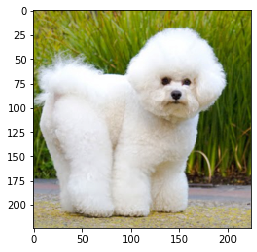

tensor([162])
tensor([True])


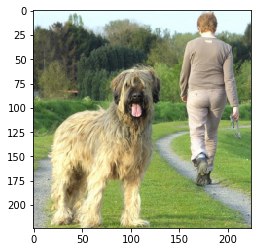

tensor([162])
tensor([True])


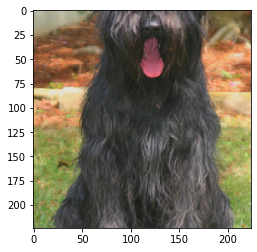

tensor([162])
tensor([True])


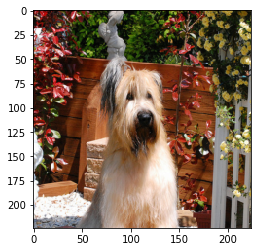

tensor([162])
tensor([True])


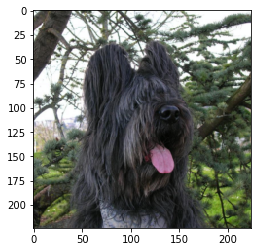

tensor([162])
tensor([True])


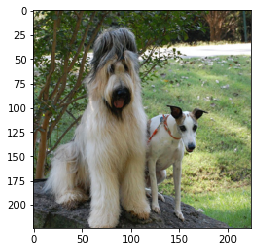

tensor([162])
tensor([True])


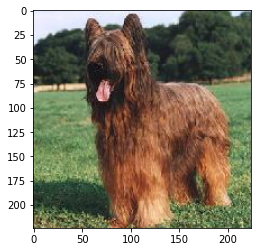

tensor([162])
tensor([True])


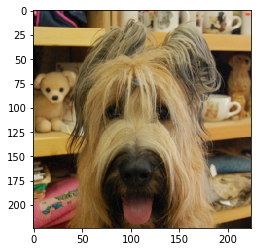

tensor([162])
tensor([True])


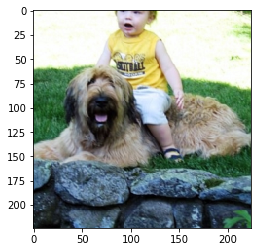

tensor([162])
tensor([True])


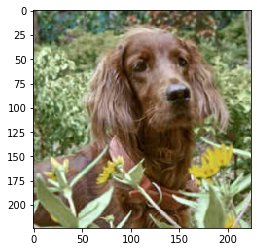

tensor([162])
tensor([True])


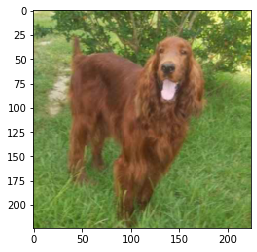

tensor([162])
tensor([True])


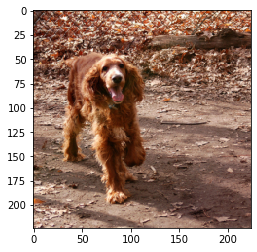

tensor([162])
tensor([True])


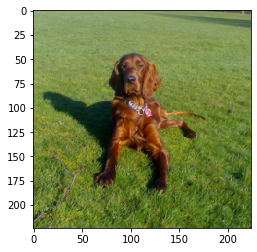

tensor([162])
tensor([True])


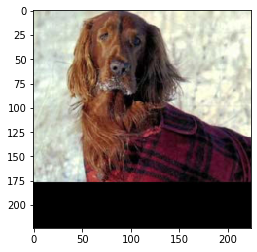

tensor([162])
tensor([True])


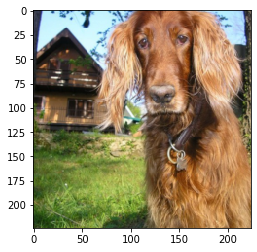

tensor([162])
tensor([True])


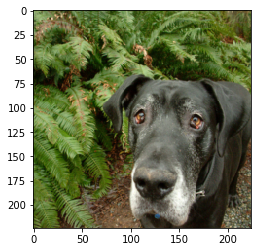

tensor([162])
tensor([True])


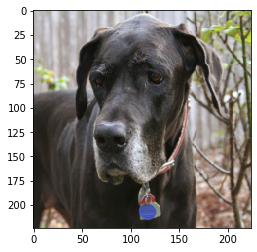

tensor([162])
tensor([True])


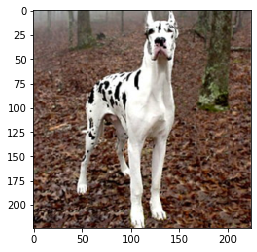

tensor([162])
tensor([True])


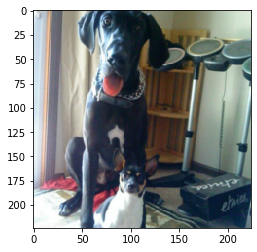

tensor([162])
tensor([True])


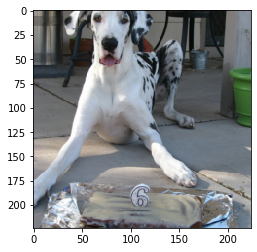

tensor([162])
tensor([True])


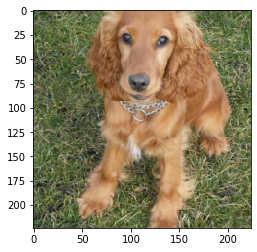

tensor([162])
tensor([True])


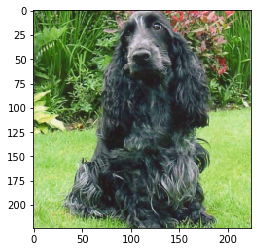

tensor([162])
tensor([True])


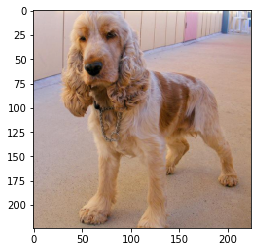

tensor([162])
tensor([True])


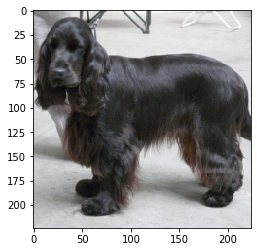

tensor([162])
tensor([True])


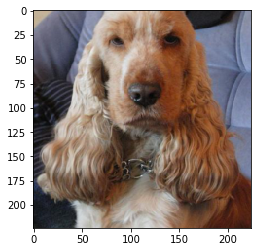

tensor([162])
tensor([True])


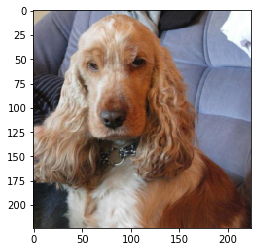

tensor([162])
tensor([True])


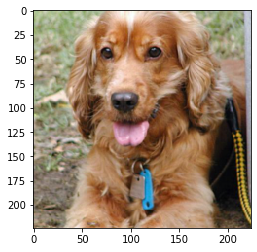

tensor([162])
tensor([True])


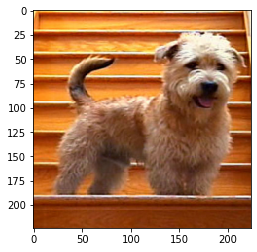

tensor([162])
tensor([True])


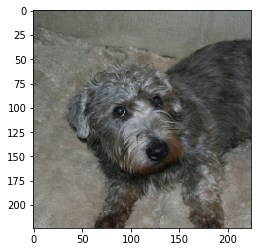

tensor([162])
tensor([True])


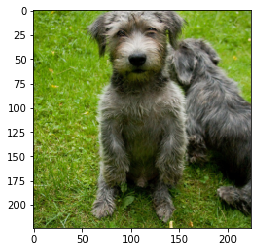

tensor([162])
tensor([True])


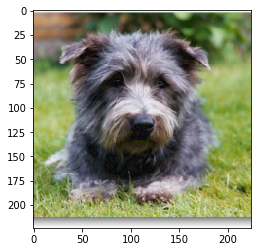

tensor([162])
tensor([True])


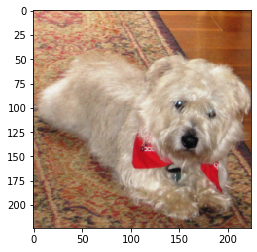

tensor([162])
tensor([True])


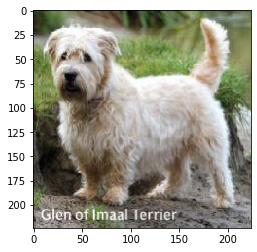

tensor([162])
tensor([True])


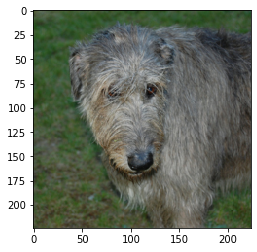

tensor([162])
tensor([True])


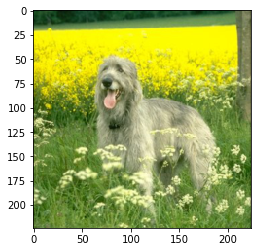

tensor([162])
tensor([True])


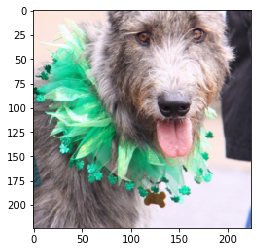

tensor([162])
tensor([True])


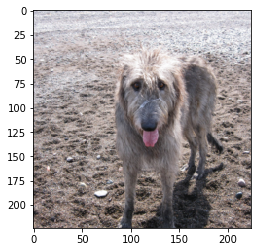

tensor([162])
tensor([True])


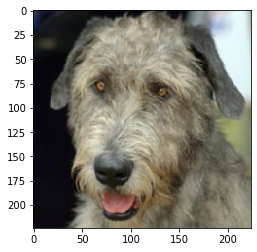

tensor([162])
tensor([True])


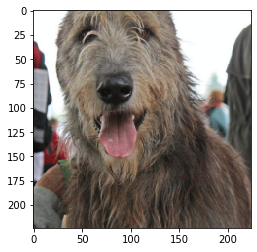

tensor([162])
tensor([True])


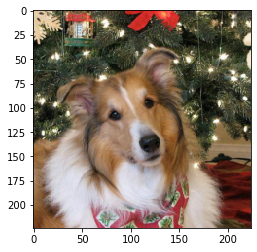

tensor([162])
tensor([True])


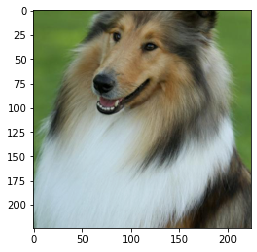

tensor([162])
tensor([True])


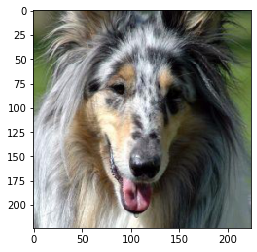

tensor([162])
tensor([True])


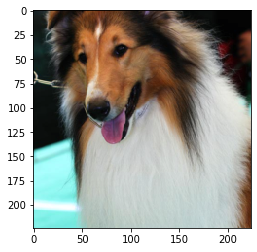

tensor([162])
tensor([True])


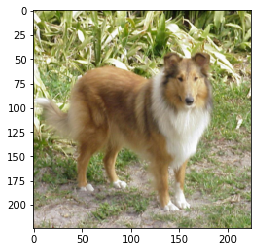

tensor([162])
tensor([True])


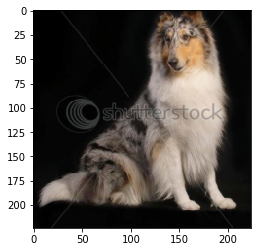

tensor([162])
tensor([True])


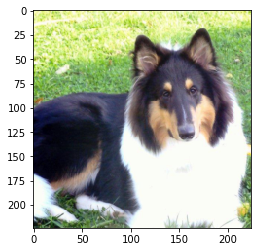

tensor([162])
tensor([True])


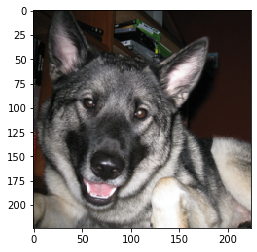

tensor([162])
tensor([True])


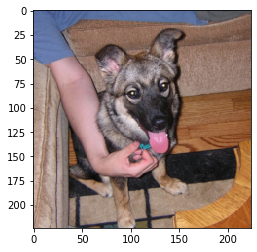

tensor([162])
tensor([True])


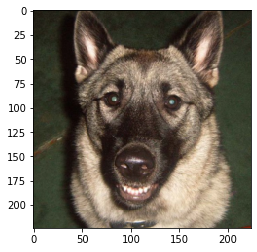

tensor([162])
tensor([True])


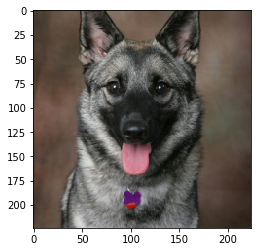

tensor([162])
tensor([True])


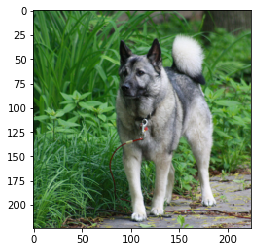

tensor([162])
tensor([True])


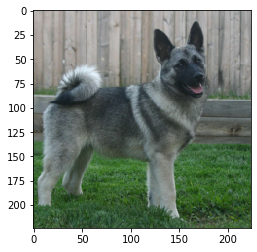

tensor([162])
tensor([True])


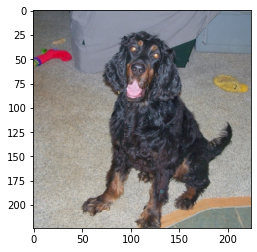

tensor([162])
tensor([True])


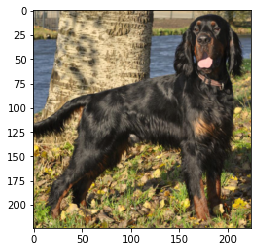

tensor([162])
tensor([True])


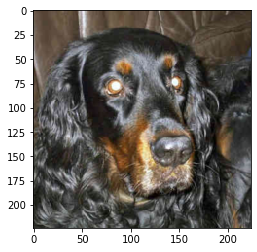

tensor([162])
tensor([True])


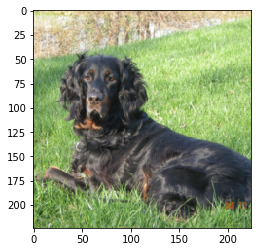

tensor([162])
tensor([True])


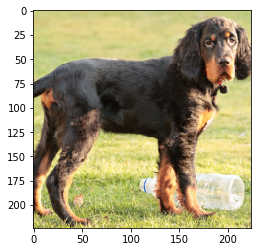

tensor([162])
tensor([True])


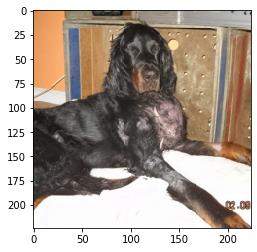

tensor([162])
tensor([True])


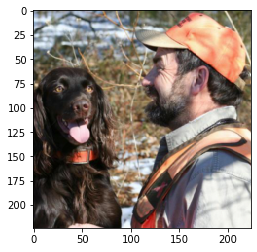

tensor([162])
tensor([True])


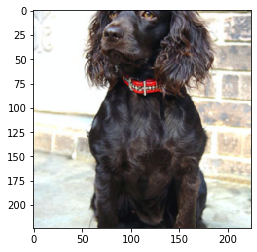

tensor([162])
tensor([True])


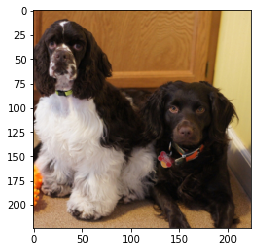

tensor([162])
tensor([True])


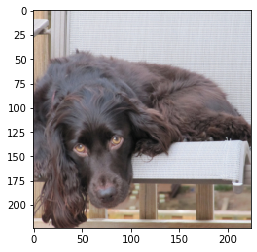

tensor([162])
tensor([True])


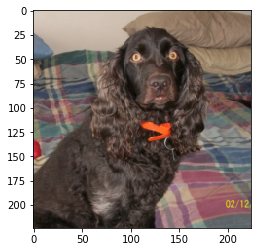

tensor([162])
tensor([True])


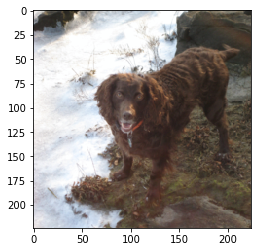

tensor([162])
tensor([True])


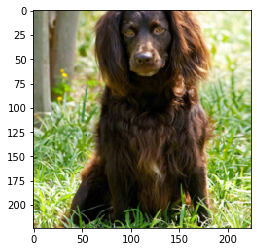

tensor([162])
tensor([True])


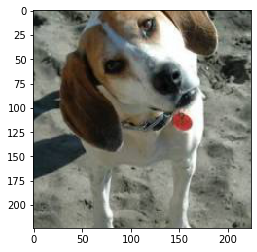

tensor([162])
tensor([True])

Result:
Percentage of human beings detected as dogs:  0 %
Percentage of dogs detected as dogs:  97 %


In [112]:
### TODO: Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.
counter_human_as_dog = 0
counter_dog_as_dog = 0

for image_path_human, image_path_dog in zip(human_files_short, dog_files_short):
    
    if dog_detector(image_path_human) == True:
        counter_human_as_dog += 1
        # plot the Tensor image
        img = transform_to_tensor(image_path_human)
        plt.imshow(im_convert(img))
        plt.show()
        
        # VGG16_predict(dog_files[1])
        print(VGG16_predict(img_path))
        print(dog_detector(img_path))
    
    if dog_detector(image_path_dog) == True:
        counter_dog_as_dog += 1
        # plot the Tensor image
        img = transform_to_tensor(image_path_dog)
        plt.imshow(im_convert(img))
        plt.show()
    
        # VGG16_predict(dog_files[1])
        print(VGG16_predict(img_path))
        print(dog_detector(img_path))
    
print('')
print('Result:')
print('Percentage of human beings detected as dogs: ', counter_human_as_dog, '%')
print('Percentage of dogs detected as dogs: ', counter_dog_as_dog,'%')

We suggest VGG-16 as a potential network to detect dog images in your algorithm, but you are free to explore other pre-trained networks (such as [Inception-v3](http://pytorch.org/docs/master/torchvision/models.html#inception-v3), [ResNet-50](http://pytorch.org/docs/master/torchvision/models.html#id3), etc).  Please use the code cell below to test other pre-trained PyTorch models.  If you decide to pursue this _optional_ task, report performance on `human_files_short` and `dog_files_short`.

In [15]:
### (Optional) 
### TODO: Report the performance of another pre-trained network.
### Feel free to use as many code cells as needed.

---
<a id='step3'></a>
## Step 3: Create a CNN to Classify Dog Breeds (from Scratch)

Now that we have functions for detecting humans and dogs in images, we need a way to predict breed from images.  In this step, you will create a CNN that classifies dog breeds.  You must create your CNN _from scratch_ (so, you can't use transfer learning _yet_!), and you must attain a test accuracy of at least 10%.  In Step 4 of this notebook, you will have the opportunity to use transfer learning to create a CNN that attains greatly improved accuracy.

We mention that the task of assigning breed to dogs from images is considered exceptionally challenging.  To see why, consider that *even a human* would have trouble distinguishing between a Brittany and a Welsh Springer Spaniel.  

Brittany | Welsh Springer Spaniel
- | - 
<img src="images/Brittany_02625.jpg" width="100"> | <img src="images/Welsh_springer_spaniel_08203.jpg" width="200">

It is not difficult to find other dog breed pairs with minimal inter-class variation (for instance, Curly-Coated Retrievers and American Water Spaniels).  

Curly-Coated Retriever | American Water Spaniel
- | -
<img src="images/Curly-coated_retriever_03896.jpg" width="200"> | <img src="images/American_water_spaniel_00648.jpg" width="200">


Likewise, recall that labradors come in yellow, chocolate, and black.  Your vision-based algorithm will have to conquer this high intra-class variation to determine how to classify all of these different shades as the same breed.  

Yellow Labrador | Chocolate Labrador | Black Labrador
- | -
<img src="images/Labrador_retriever_06457.jpg" width="150"> | <img src="images/Labrador_retriever_06455.jpg" width="240"> | <img src="images/Labrador_retriever_06449.jpg" width="220">

We also mention that random chance presents an exceptionally low bar: setting aside the fact that the classes are slightly imabalanced, a random guess will provide a correct answer roughly 1 in 133 times, which corresponds to an accuracy of less than 1%.  

Remember that the practice is far ahead of the theory in deep learning.  Experiment with many different architectures, and trust your intuition.  And, of course, have fun!

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/stable/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively).  You may find [this documentation on custom datasets](http://pytorch.org/docs/stable/torchvision/datasets.html) to be a useful resource.  If you are interested in augmenting your training and/or validation data, check out the wide variety of [transforms](http://pytorch.org/docs/stable/torchvision/transforms.html?highlight=transform)!

In [10]:
### TODO: Write data loaders for training, validation, and test sets
## Specify appropriate transforms, and batch_sizes
# number of subprocesses to use for data loading

# code from Data Augmentation Section
data_dir = '/data/dog_images'
# TODO: Define transforms for the training data and testing data

resizing = 224
cropping = 224

train_transforms = transforms.Compose([transforms.RandomRotation(10),
                                       transforms.RandomResizedCrop(cropping),
                                       transforms.RandomHorizontalFlip(),
                                       transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])]) 

test_transforms = transforms.Compose([transforms.Resize(resizing),
                                      transforms.CenterCrop(cropping),
                                      transforms.ToTensor(),
                                      transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])]) 


# Pass transforms in here, then run the next cell to see how the transforms look
train_data = datasets.ImageFolder(data_dir + '/train', transform=train_transforms)
valid_data = datasets.ImageFolder(data_dir + '/valid', transform=test_transforms)
test_data = datasets.ImageFolder(data_dir + '/test', transform=test_transforms)

train_loader = torch.utils.data.DataLoader(train_data, batch_size=32, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=16)
valid_loader = torch.utils.data.DataLoader(valid_data, batch_size=16)

loaders_scratch = {'train': train_loader, 'valid': valid_loader, 'test': test_loader}

These are the labels from train data:
tensor([ 20,  10, 100,  62,  16,  94,  51,  91,  93,  50, 117, 110,   1, 116,
         57,  43, 102, 118, 127,   3,  66,  70,  82,  69, 107, 100, 122,  71,
         80,   0,  16,  88])


This is the train_label to index dictionary:
{'001.Affenpinscher': 0, '002.Afghan_hound': 1, '003.Airedale_terrier': 2, '004.Akita': 3, '005.Alaskan_malamute': 4, '006.American_eskimo_dog': 5, '007.American_foxhound': 6, '008.American_staffordshire_terrier': 7, '009.American_water_spaniel': 8, '010.Anatolian_shepherd_dog': 9, '011.Australian_cattle_dog': 10, '012.Australian_shepherd': 11, '013.Australian_terrier': 12, '014.Basenji': 13, '015.Basset_hound': 14, '016.Beagle': 15, '017.Bearded_collie': 16, '018.Beauceron': 17, '019.Bedlington_terrier': 18, '020.Belgian_malinois': 19, '021.Belgian_sheepdog': 20, '022.Belgian_tervuren': 21, '023.Bernese_mountain_dog': 22, '024.Bichon_frise': 23, '025.Black_and_tan_coonhound': 24, '026.Black_russian_terrier': 25, '027.Bl

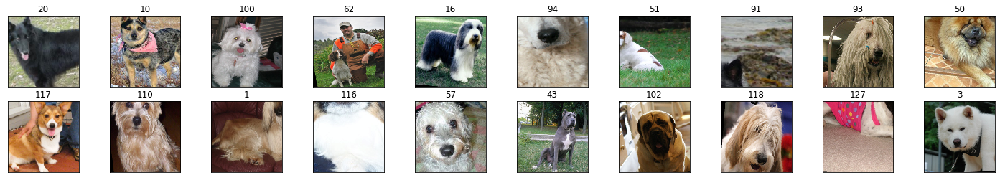

In [17]:
%matplotlib inline
# obtain one batch of training images
dataiter = iter(train_loader)
images, labels = dataiter.next()

#images = images.numpy()
print('These are the labels from train data:')
print(labels)
print('\n')
print('This is the train_label to index dictionary:')
print(train_data.class_to_idx)
    
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    ax.imshow(im_convert(images[idx]))
    # print out the correct label for each image
    # .item() gets the value contained in a Tensor
    ax.set_title(str(labels[idx].item()))

**Question 3:** Describe your chosen procedure for preprocessing the data. 
- How does your code resize the images (by cropping, stretching, etc)?  What size did you pick for the input tensor, and why?
- Did you decide to augment the dataset?  If so, how (through translations, flips, rotations, etc)?  If not, why not?


**Answer**:
My answer is based on research under https://pytorch.org/docs/stable/torchvision/transforms.html

For Training I use Data Augmentation with the following transformations:  
- transforms.RandomRotation(10) --> random Rotation of the image. The range of degrees will be (-10, +10).
- transforms.RandomResizedCrop(224) --> This will extract a patch of size (224, 224) from the input image randomly.
- transforms.RandomHorizontalFlip() --> Once the image is of size (224, 224), horizontal flipping can be applied.
- transforms.ToTensor() --> This transforms the image to a tensor.
- transforms.Normalize[0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) --> data scaling to normalize the Tensor (1st list = mean, 2nd list = std),values are given by torchvision.

For Validation and Testing I do not use Data Augmentation. The following transformations are aplied:
- transforms.Resize(224) --> smaller edge of the image will be matched to this 224. i.e, if height > width, then image will be rescaled to (size * height / width, size).
- transforms.CenterCrop(224) --> Crops the given image at the center. A square crop (224, 224) is made.
- transforms.ToTensor() --> This transforms the image to a tensor.
- transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])]) --> data scaling to normalize the Tensor (1st list = mean, 2nd list = std),values are given by torchvision.

Based on the documentation of torchvision.models https://pytorch.org/docs/stable/torchvision/models.html I have chosen 224 pixel as the input size. All pre-trained torchvision models expect input images normalized in the same way, i.e. mini-batches of 3-channel RGB images of shape (3 x H x W), where H and W are expected to be at least 224. The images have to be loaded in to a range of [0, 1] and then normalized using mean = [0.485, 0.456, 0.406] and std = [0.229, 0.224, 0.225].

### (IMPLEMENTATION) Model Architecture

Create a CNN to classify dog breed.  Use the template in the code cell below.

In [11]:
import torch.nn as nn
import torch.nn.functional as F

# define the CNN architecture
class Net(nn.Module):
    ### TODO: choose an architecture, and complete the class
    def __init__(self):
        super(Net, self).__init__()
        ## Define layers of a CNN
        self.conv1 = nn.Conv2d(3, 16, 3, padding=1)
        self.conv2 = nn.Conv2d(16, 32, 3, padding=1)
        self.conv3 = nn.Conv2d(32, 64, 3, padding=1)
        # max pooling layer
        self.pool = nn.MaxPool2d(2, 2)
        
        # dropout (p=0.2)
        self.dropout = nn.Dropout(0.2)
        
        # FC Network, classifier
        self.fc1 = nn.Linear(28*28*64,500)
        self.fc2 = nn.Linear(500,133)

    def forward(self, x):
        ## Define layers of a CNN
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        x = x.view(-1,28*28*64)
        x = self.dropout(x)
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        
        return x

#-#-# You so NOT have to modify the code below this line. #-#-#

# instantiate the CNN
model_scratch = Net()

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()
    
    
print(model_scratch)

Net(
  (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (dropout): Dropout(p=0.2)
  (fc1): Linear(in_features=50176, out_features=500, bias=True)
  (fc2): Linear(in_features=500, out_features=133, bias=True)
)


__Question 4:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  

__Answer:__ 
The Net class is divided into two functions: The init-function and the forward-function.

In the init-function I define the Conv, MaxPool and FC layers as well as a dropout regularization.
There are three Conv-layers for a feature extraction with growing depth from depth=3 via depth=16 to depth=32. The Kernel size of these layers is 3 (3x3 squared window) with a stride and padding of 1. These stride and padding values ensure that the image size (width and height) in each Conv-Layers is not changed.

A MaxPooling Layer initialized in the init-function with Kernel of 2 and a stride of 2 bisects the image width and height every time when it occurs in the forward pass. It is used for feature reduction.

In the forward pass I start with a Conv layer which is defined in the init function, apply a ReLU as an activation function and bisect the width and height of the image via a MaxPoling layer. This layer combination Conv-ReLU-MaxPool appears three times for a deeply enough feature extraction and an appropriate image size/feature reduction.

Next I apply a dropout regularization to reduce overfitting.

A first fully connected layer takes in all the 50176 parameters. This number is the result of the product of the image size of the last MaxPooling-Layer (28x28) with the final depth of 64. I set the number of out_features arbitrary to 500. 

Before implementing the classifier I set another dropout layer to minimize overfitting. 

In a second fully connected layer (classifier) I turn these 500 in_features into the number of final classes (number of dog breeds) which is 133.

As a final result the prediction (x) will be returned from the forward function.

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/stable/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/stable/optim.html).  Save the chosen loss function as `criterion_scratch`, and the optimizer as `optimizer_scratch` below.

In [12]:
import torch.optim as optim

### TODO: select loss function
criterion_scratch = nn.CrossEntropyLoss()

### TODO: select optimizer
optimizer_scratch = optim.SGD(model_scratch.parameters(), lr = 0.01)

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_scratch.pt'`.

In [20]:
!pip show pillow

Name: Pillow
Version: 6.2.1
Summary: Python Imaging Library (Fork)
Home-page: http://python-pillow.org
Author: Alex Clark (PIL Fork Author)
Author-email: aclark@python-pillow.org
License: HPND
Location: /anaconda3/lib/python3.7/site-packages
Requires: 
Required-by: torchvision, scikit-image, pytesseract, bokeh


In [92]:
#from workspace_utils import active_session

def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path):
    """returns trained model"""
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    # exist save-file, load save file
    #if os.path.exists(save_path):
    #    print("load previous saved model ...")
    #    model.load_state_dict(torch.load(save_path))
    #with active_session():    
    for epoch in range(1, n_epochs+1):
            # initialize variables to monitor training and validation loss
            train_loss = 0.0
            valid_loss = 0.0

            ###################
            # train the model #
            ###################
            model.train()
            for batch_idx, (data, target) in enumerate(loaders['train']):
                # move to GPU
                if use_cuda:
                    data, target = data.cuda(), target.cuda()
                ## find the loss and update the model parameters accordingly
                ## record the average training loss, using something like
                ## train_loss = train_loss + ((1 / (batch_idx + 1)) * (loss.data - train_loss))

                # clear the gradients of all optimized variables
                optimizer.zero_grad()
                # forward pass: compute predicted outputs by passing inputs to the model
                output = model(data)
                # calculate the batch loss
                loss = criterion(output, target)
                # backward pass: compute gradient of the loss with respect to model parameters
                loss.backward()
                # perform a single optimization step (parameter update)
                optimizer.step()
                # update training loss
                train_loss += loss.item()*data.size(0)
                #train_loss_2 = train_loss_2 + ((1 / (batch_idx + 1)) * (loss.data - train_loss_2))

            ######################    
            # validate the model #
            ######################
            model.eval()
            for batch_idx, (data, target) in enumerate(loaders['valid']):
                # move to GPU
                if use_cuda:
                    data, target = data.cuda(), target.cuda()
                ## update the average validation loss

                # forward pass: compute predicted outputs by passing inputs to the model
                output = model(data)
                # calculate the batch loss
                loss = criterion(output, target)
                # update average validation loss 
                valid_loss += loss.item()*data.size(0)


            # calculate average losses
            train_loss = train_loss/len(train_loader.dataset)
            valid_loss = valid_loss/len(valid_loader.dataset)

            # print training/validation statistics 
            print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
                epoch, train_loss, valid_loss))

            ## TODO: save the model if validation loss has decreased
            # save model if validation loss has decreased
            if valid_loss <= valid_loss_min:
                print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
                valid_loss_min,
                valid_loss))
                torch.save(model.state_dict(), save_path)
                valid_loss_min = valid_loss

            
            
    # return trained model
    return model

In [93]:
# train the model
model_scratch = train(50, loaders_scratch, model_scratch, optimizer_scratch, 
                      criterion_scratch, use_cuda, 'model_scratch.pt')

Epoch: 1 	Training Loss: 4.877723 	Validation Loss: 4.847110
Validation loss decreased (inf --> 4.847110).  Saving model ...
Epoch: 2 	Training Loss: 4.823086 	Validation Loss: 4.761185
Validation loss decreased (4.847110 --> 4.761185).  Saving model ...
Epoch: 3 	Training Loss: 4.759107 	Validation Loss: 4.670431
Validation loss decreased (4.761185 --> 4.670431).  Saving model ...
Epoch: 4 	Training Loss: 4.707069 	Validation Loss: 4.590549
Validation loss decreased (4.670431 --> 4.590549).  Saving model ...
Epoch: 5 	Training Loss: 4.627367 	Validation Loss: 4.497707
Validation loss decreased (4.590549 --> 4.497707).  Saving model ...
Epoch: 6 	Training Loss: 4.569565 	Validation Loss: 4.439622
Validation loss decreased (4.497707 --> 4.439622).  Saving model ...
Epoch: 7 	Training Loss: 4.542529 	Validation Loss: 4.405929
Validation loss decreased (4.439622 --> 4.405929).  Saving model ...
Epoch: 8 	Training Loss: 4.500957 	Validation Loss: 4.374430
Validation loss decreased (4.40592

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images.  Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 10%.

In [ ]:
# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))

def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

# call test function    
test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

---
<a id='step4'></a>
## Step 4: Create a CNN to Classify Dog Breeds (using Transfer Learning)

You will now use transfer learning to create a CNN that can identify dog breed from images.  Your CNN must attain at least 60% accuracy on the test set.

### (IMPLEMENTATION) Specify Data Loaders for the Dog Dataset

Use the code cell below to write three separate [data loaders](http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader) for the training, validation, and test datasets of dog images (located at `dogImages/train`, `dogImages/valid`, and `dogImages/test`, respectively). 

If you like, **you are welcome to use the same data loaders from the previous step**, when you created a CNN from scratch.

In [45]:
## TODO: Specify data loaders
loaders_transfer = loaders_scratch

### (IMPLEMENTATION) Model Architecture

Use transfer learning to create a CNN to classify dog breed.  Use the code cell below, and save your initialized model as the variable `model_transfer`.

In [46]:
import torchvision.models as models
import torch.nn as nn

## TODO: Specify model architecture 
model_transfer = models.vgg19(pretrained=True)


if use_cuda:
    model_transfer = model_transfer.cuda()
    print('GPU is used')
    
print(model_transfer)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [47]:
# Freeze parameters so we don't backprop through them
for param in model_transfer.parameters():
    param.requires_grad = False

In [49]:
model_transfer.classifier[6] = nn.Linear(4096, 133, bias=True)
#model_transfer.classifier = classifier
print(model_transfer)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

__Question 5:__ Outline the steps you took to get to your final CNN architecture and your reasoning at each step.  Describe why you think the architecture is suitable for the current problem.

__Answer:__ 
I just replaced the last layer of the classifier of VGG19 pretrained model, i.e. classifier(6.) 

This is important to adjust the number of classes. The number of classes in the VGG19 approach is 1000. In the dog-breed-project I only have 133 classes. Hence, only the number of 'out_features' in classifier(6) is replaced by 133.

### (IMPLEMENTATION) Specify Loss Function and Optimizer

Use the next code cell to specify a [loss function](http://pytorch.org/docs/master/nn.html#loss-functions) and [optimizer](http://pytorch.org/docs/master/optim.html).  Save the chosen loss function as `criterion_transfer`, and the optimizer as `optimizer_transfer` below.

In [67]:
#criterion_transfer = nn.NLLLoss()
criterion_transfer = nn.CrossEntropyLoss()
optimizer_transfer = optim.SGD(filter(lambda p: p.requires_grad,model_transfer.parameters()), lr=0.01)

### (IMPLEMENTATION) Train and Validate the Model

Train and validate your model in the code cell below.  [Save the final model parameters](http://pytorch.org/docs/master/notes/serialization.html) at filepath `'model_transfer.pt'`.

In [68]:
# train the model
n_epochs=10
model_transfer = train(n_epochs, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'model_transfer.pt')


Epoch: 1 	Training Loss: 5.038955 	Validation Loss: 2.050429
Validation loss decreased (inf --> 2.050429).  Saving model ...
Epoch: 2 	Training Loss: 4.743845 	Validation Loss: 2.036523
Validation loss decreased (2.050429 --> 2.036523).  Saving model ...
Epoch: 3 	Training Loss: 4.770967 	Validation Loss: 2.025501
Validation loss decreased (2.036523 --> 2.025501).  Saving model ...
Epoch: 4 	Training Loss: 4.611585 	Validation Loss: 2.027045
Epoch: 5 	Training Loss: 4.777040 	Validation Loss: 2.049218
Epoch: 6 	Training Loss: 4.768313 	Validation Loss: 2.014951
Validation loss decreased (2.025501 --> 2.014951).  Saving model ...
Epoch: 7 	Training Loss: 5.098578 	Validation Loss: 2.008340
Validation loss decreased (2.014951 --> 2.008340).  Saving model ...
Epoch: 8 	Training Loss: 4.662475 	Validation Loss: 1.994946
Validation loss decreased (2.008340 --> 1.994946).  Saving model ...
Epoch: 9 	Training Loss: 4.811388 	Validation Loss: 1.971707
Validation loss decreased (1.994946 --> 1.

In [69]:
# load the model that got the best validation accuracy (uncomment the line below)
model_transfer.load_state_dict(torch.load('model_transfer.pt'))

<All keys matched successfully>

### (IMPLEMENTATION) Test the Model

Try out your model on the test dataset of dog images. Use the code cell below to calculate and print the test loss and accuracy.  Ensure that your test accuracy is greater than 60%.

In [70]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 2.903815


Test Accuracy: 88% (738/836)


### (IMPLEMENTATION) Predict Dog Breed with the Model

Write a function that takes an image path as input and returns the dog breed (`Affenpinscher`, `Afghan hound`, etc) that is predicted by your model.  

In [78]:
### TODO: Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.

# list of class names by index, i.e. a name can be accessed like class_names[0]
class_names = [item[4:].replace("_", " ") for item in train_data.classes]

def predict_breed_transfer(img_path):
    # load the image and return the predicted breed
    # transform iamege to tensor   
    image_as_tensor = transform_to_tensor(img_path)

    # move model inputs to cuda, if GPU available
    if use_cuda:
        image_as_tensor = image_as_tensor.cuda()

    # predicted output
    output = model_transfer(image_as_tensor)
    # convert output probabilities to predicted class
    _, preds_as_tensor = torch.max(output, 1)
    pred_index = np.squeeze(preds_as_tensor.numpy()) if not use_cuda else np.squeeze(preds_as_tensor.cpu().numpy())
    
    return class_names[pred_index]

In [79]:
def display_image(img_path, title=''):
    image = Image.open(img_path)
    plt.title(title)
    plt.imshow(image)
    plt.show()

---
<a id='step5'></a>
## Step 5: Write your Algorithm

Write an algorithm that accepts a file path to an image and first determines whether the image contains a human, dog, or neither.  Then,
- if a __dog__ is detected in the image, return the predicted breed.
- if a __human__ is detected in the image, return the resembling dog breed.
- if __neither__ is detected in the image, provide output that indicates an error.

You are welcome to write your own functions for detecting humans and dogs in images, but feel free to use the `face_detector` and `dog_detector` functions developed above.  You are __required__ to use your CNN from Step 4 to predict dog breed.  

Some sample output for our algorithm is provided below, but feel free to design your own user experience!

![Sample Human Output](images/sample_human_output.png)


### (IMPLEMENTATION) Write your Algorithm

In [80]:
### TODO: Write your algorithm.
### Feel free to use as many code cells as needed.

def run_app(img_path):
    ## handle cases for a human face, dog, and neither
    
    # human face?:
    if (face_detector(img_path)):
        print("You seem to be a human being")
        predicted_breed = predict_breed_transfer(img_path)
        display_image(img_path, title="Predicted breed: {}".format(predicted_breed) )
        
        print("But you look like a ...")
        print(predicted_breed)
        
    # dog?:
    elif dog_detector(img_path):
        print("You seem to be a dog!")
        predicted_breed = predict_breed_transfer(img_path)
        display_image(img_path, title="Predicted breed: {}".format(predicted_breed) )
        
        print("The dog breed is most likley ...")
        print(predicted_breed)
    # neither
    else:
        print("In this image does not seem to show a human face or a dog.")
        display_image(img_path, title="...")
        print("Try another!")
        
    print("\n")


    


---
<a id='step6'></a>
## Step 6: Test Your Algorithm

In this section, you will take your new algorithm for a spin!  What kind of dog does the algorithm think that _you_ look like?  If you have a dog, does it predict your dog's breed accurately?  If you have a cat, does it mistakenly think that your cat is a dog?

### (IMPLEMENTATION) Test Your Algorithm on Sample Images!

Test your algorithm at least six images on your computer.  Feel free to use any images you like.  Use at least two human and two dog images.  

__Question 6:__ Is the output better than you expected :) ?  Or worse :( ?  Provide at least three possible points of improvement for your algorithm.

__Answer:__ (Three possible points for improvement)

In my opinion the tool of transfer learning is very impressive. I only used 5 epochs for traini and got a really good accuracy for testing of about 88%

Ways to improve the result:
- There is still no overfitting after 10 epochs of training the classifier. I could enlarge the number of epochs to get even better results. 
- I could add another Conv-MaxPool layer block to further increase the depth and hence the feature extraction.
- I could try to reduce the learning rate.
- I could use a different optimizer, e.g. Adagrad Optimizer with an adaptive Learning rate

You seem to be a human being


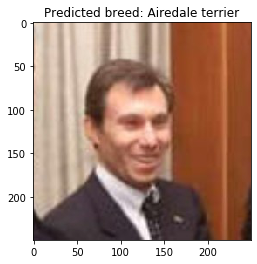

But you look like a ...
Airedale terrier


You seem to be a human being


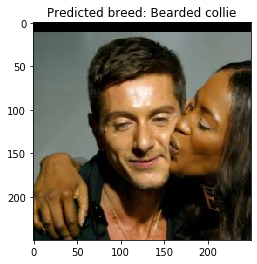

But you look like a ...
Bearded collie


You seem to be a human being


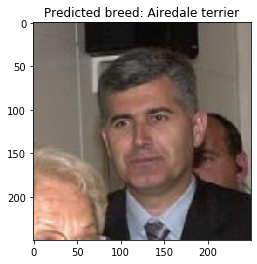

But you look like a ...
Airedale terrier


You seem to be a human being


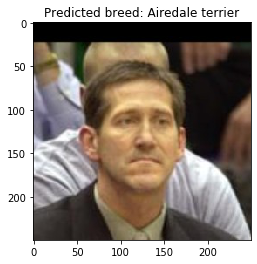

But you look like a ...
Airedale terrier


You seem to be a human being


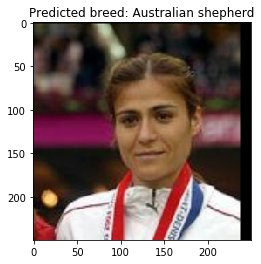

But you look like a ...
Australian shepherd


You seem to be a human being


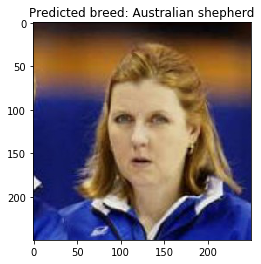

But you look like a ...
Australian shepherd


You seem to be a human being


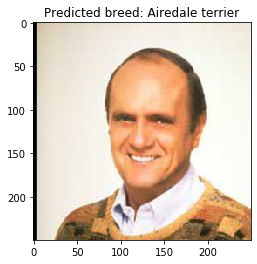

But you look like a ...
Airedale terrier


You seem to be a human being


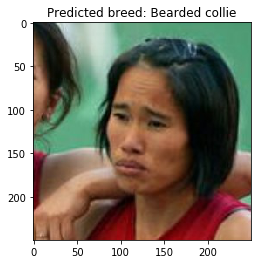

But you look like a ...
Bearded collie


You seem to be a human being


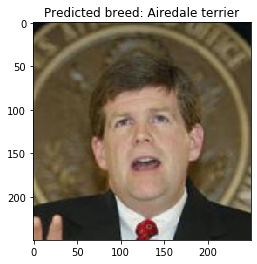

But you look like a ...
Airedale terrier


You seem to be a human being


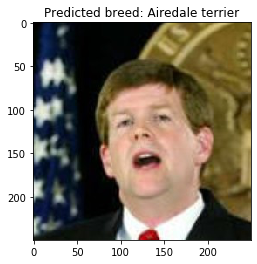

But you look like a ...
Airedale terrier


You seem to be a dog!


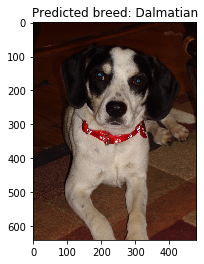

The dog breed is most likley ...
Dalmatian


You seem to be a dog!


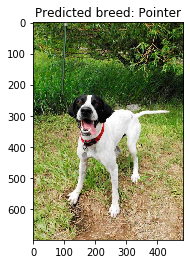

The dog breed is most likley ...
Pointer


You seem to be a human being


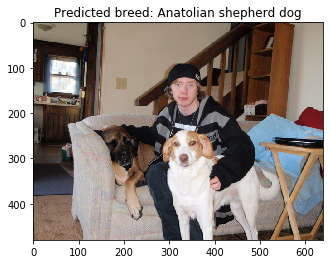

But you look like a ...
Anatolian shepherd dog


You seem to be a dog!


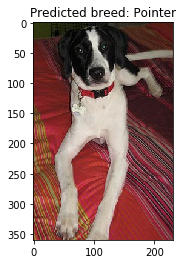

The dog breed is most likley ...
Pointer


You seem to be a dog!


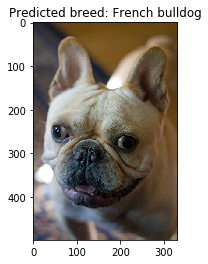

The dog breed is most likley ...
French bulldog


You seem to be a dog!


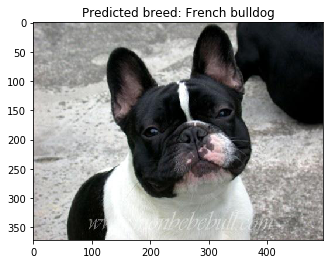

The dog breed is most likley ...
French bulldog


You seem to be a dog!


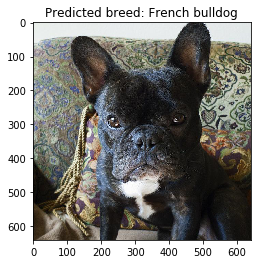

The dog breed is most likley ...
French bulldog


You seem to be a dog!


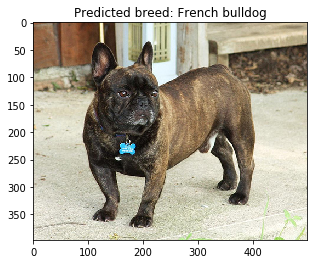

The dog breed is most likley ...
French bulldog


You seem to be a dog!


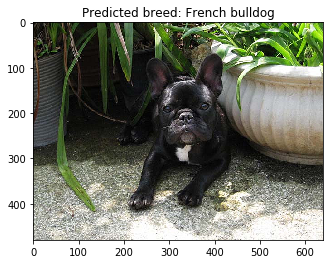

The dog breed is most likley ...
French bulldog


You seem to be a dog!


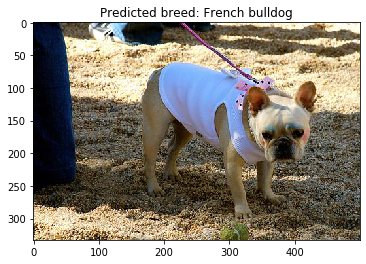

The dog breed is most likley ...
French bulldog




In [82]:
## TODO: Execute your algorithm from Step 6 on
## at least 6 images on your computer.
## Feel free to use as many code cells as needed.

## suggested code, below
for file in np.hstack((human_files[:10], dog_files[:10])):
    run_app(file)